## First llok at the submitted MBHB results

In [1]:
from lisacattools.catalog import GWCatalogs, GWCatalogType
from chainconsumer import ChainConsumer
import numpy as np

import corner

import ldc.io.hdf5 as h5io
import pandas as pd
from tqdm import tqdm
import csv

import lisabeta
import lisabeta.tools.pytools as pytools
from ldc.common.tools import compute_tdi_snr, trigo

from scipy import stats
from scipy.interpolate import InterpolatedUnivariateSpline as spline

import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.colors as colors
%matplotlib inline

# plt.style.use(['seaborn-ticks','seaborn-deep'])
plt.style.use(['seaborn-v0_8-ticks','seaborn-v0_8-deep'])

# %pylab inline

mpl.rcParams.update({'font.size': 16})
plt.rcParams['axes.grid'] = True
plt.rcParams["figure.figsize"] = (12,7)

%load_ext autoreload
%autoreload 2

import matplotlib.pyplot as plt

import logging, sys
logging.disable(sys.maxsize)

In [2]:
import lisaconstants as constants

light = constants.C
YRSID_SI = constants.SIDEREALYEAR_J2000DAY*24*60*60
PARSEC_METER = constants.PARSEC_METER
MTsun = constants.GM_SUN/constants.SPEED_OF_LIGHT**3
AU = constants.ASTRONOMICAL_UNIT/light
Gpct = 1.e9*constants.PARSEC_METER/constants.SPEED_OF_LIGHT

### Reading Sangria MBHB params 

In [3]:
import ldc.io.hdf5 as h5io
import pandas as pd
sangria_fl = '/Users/stas/Projects/LISA/Sangria/Data/LDC2_sangria_training_v2.h5'
mbhb_sangria, mbhb_units = h5io.load_array(sangria_fl, name="sky/mbhb/cat")
pd.DataFrame(mbhb_sangria)

,EclipticLatitude,EclipticLongitude,PolarAngleOfSpin1,PolarAngleOfSpin2,Spin1,Spin2,Mass1,Mass2,CoalescenceTime,PhaseAtCoalescence,InitialPolarAngleL,InitialAzimuthalAngleL,Redshift,Distance,ObservationDuration,Cadence
0,-0.564102,0.610927,0.908972,1.181699,0.972661,0.972862,1.015522e+06,7.968491e+05,4.800021e+06,4.275929,2.577539,4.094550,2.18186,17758.367941,3.155815e+07,3.0
1,-1.081082,4.052963,2.354232,1.689765,0.742128,0.989247,4.956676e+06,4.067167e+06,8.746488e+06,3.783309,0.963586,3.636925,6.17688,61097.116076,3.155815e+07,3.0
2,0.636028,0.779159,2.332027,2.065443,0.574122,0.592671,1.773563e+06,1.083356e+06,1.116784e+07,2.311127,0.232802,3.798411,6.03496,59472.237592,3.155815e+07,3.0
3,-0.878570,4.549720,2.068669,1.097989,0.942824,0.870789,9.159926e+05,7.017527e+05,1.125857e+07,1.150360,1.899782,5.829771,1.10396,7705.852640,3.155815e+07,3.0
4,-0.303004,1.292518,1.203136,2.097304,0.747377,0.838800,1.323277e+06,6.124855e+05,1.152694e+07,1.220197,2.691982,1.808398,1.73941,13470.983559,3.155815e+07,3.0
5,0.147296,5.986230,2.434152,1.926613,0.745574,0.546848,2.830218e+06,2.322253e+06,1.197096e+07,4.111379,1.131250,4.319761,5.50770,53474.693790,3.155815e+07,3.0
6,-0.987304,3.886726,2.594339,1.719446,0.829141,0.972219,3.204750e+06,3.056613e+06,1.361711e+07,3.628682,2.050928,1.084370,2.87966,24829.137775,3.155815e+07,3.0
7,0.917031,3.584892,1.665850,2.092903,0.988778,0.975945,1.856420e+06,1.801541e+06,1.653219e+07,1.866057,1.410068,0.527915,4.57261,43010.925050,3.155815e+07,3.0
8,0.835250,3.257316,2.362671,1.539846,0.833674,0.981901,3.983915e+06,2.049535e+06,1.724516e+07,1.578620,2.323179,3.643228,3.34910,29747.551597,3.155815e+07,3.0
9,-0.521369,3.085541,2.582941,2.200156,0.825883,0.811360,3.128823e+06,2.640346e+06,1.860576e+07,3.425317,2.604701,1.670016,7.21026,73048.167218,3.155815e+07,3.0


In [4]:
import lisabeta
import lisabeta.tools.pytools as pytools
from ldc.common.tools import compute_tdi_snr, trigo
# "Mass 1", "Mass 2", "Spin 1", "Spin 2", "Ecliptic Longitude", "Ecliptic Latitude", 
# "Luminosity Distance"

def MakeSourceDic(x, name='MBHB'):
    y = {}
    for ii in range(len(x)):
        # print (x.dtype.names[ii])
        y[x.dtype.names[ii]] = x[ii]
    y['m1'] = y['Mass1']/(1+y['Redshift'])
    y['m2'] = y['Mass2']/(1+y['Redshift'])
    
    y = pytools.complete_mass_params(y)
    y["Name"] = name
    
    psi, incl = trigo.aziPolAngleL2PsiIncl(y['EclipticLatitude'], y['EclipticLongitude'], y['InitialPolarAngleL'], y['InitialAzimuthalAngleL'])
    
    y['Inclination'] = incl
    y['Polarization'] = psi
    y['chi1'] = x['Spin1']*np.cos(x['PolarAngleOfSpin1'])
    y['chi2'] = x['Spin2']*np.cos(x['PolarAngleOfSpin2'])
    
    
    return(y)

cats = []
for ii in range(len(mbhb_sangria)):
    cat_src = mbhb_sangria[ii]
    tru_src = MakeSourceDic(cat_src)
    print ('Tc = ', tru_src['CoalescenceTime']/YRSID_SI)
#     print (tru_src)
    cats.append(tru_src)
    
# ind = 0
# cat = mbhb_sangria[0]

# tru_src = MakeSourceDic(cat)
# print ('Tc = ', tru_src['CoalescenceTime'])
# tr_cat = np.array([tru_src['Mass1'], tru_src['Mass2'], tru_src['chi1'], tru_src['chi2'], \
# # tr_cat = np.array([tru_src['m1'], tru_src['m2'], tru_src['chi1'], tru_src['chi2'], \
#                    tru_src['EclipticLongitude'], tru_src['EclipticLatitude'], tru_src['Distance']*1.e-3])

print (cats[0])

Tc =  0.15210084214991826
Tc =  0.27715466635824726
Tc =  0.35388143873113825
Tc =  0.3567564594108712
Tc =  0.36526047972541825
Tc =  0.3793303654498056
Tc =  0.43149275873946624
Tc =  0.5238644113086524
Tc =  0.5464564979724776
Tc =  0.5895706258820336
Tc =  0.6472566519961181
Tc =  0.7043526864454542
Tc =  0.7427507415175312
Tc =  0.7734535179753902
Tc =  0.9352921499250013
{'EclipticLatitude': -0.5641023936335077, 'EclipticLongitude': 0.6109268516130327, 'PolarAngleOfSpin1': 0.9089723456902256, 'PolarAngleOfSpin2': 1.1816994499122777, 'Spin1': 0.972661, 'Spin2': 0.972862, 'Mass1': 1015522.4376, 'Mass2': 796849.1091, 'CoalescenceTime': 4800021.15572853, 'PhaseAtCoalescence': 4.275929308696054, 'InitialPolarAngleL': 2.5775388853549464, 'InitialAzimuthalAngleL': 4.094550225563854, 'Redshift': 2.18186, 'Distance': 17758.367941273442, 'ObservationDuration': 31558149.763545603, 'Cadence': 3.0, 'm1': 319160.0, 'm2': 250435.0, 'Mchirp': 245758.6738335766, 'eta': 0.2463605381692381, 'M': 56

### Let me try to compute SNR for each Sangria MBHB

In [5]:
from ldc.waveform.lisabeta import FastBHB
from ldc.common.tools import compute_tdi_snr
from ldc.lisa.noise import get_noise_model
from ldc.common.series import TimeSeries, FrequencySeries, TDI


In [27]:
Nmodel = get_noise_model('sangria', np.logspace(-5, -1, 100))

tmax = 60*60*24*365
dt = 5

# mbhb_sangria, mbhb_units
SNRs = []
for s_index in range(len(mbhb_sangria)): 
    pMBHB = dict(zip(mbhb_sangria.dtype.names, mbhb_sangria[s_index]))
    FBH = FastBHB("MBHB", T=tmax, delta_t=dt, approx="IMRPhenomD")

    A,E,T = FBH.get_fd_tdiaet(template=pMBHB)
    AET = TDI(dict(zip(["A", "E", "T"], [A, E, T])))
    snr = np.sqrt(compute_tdi_snr(AET, Nmodel, AET=True)["tot2"])
    SNRs.append(snr)
print (SNRs)

[3167.066686975339, 303.4155213539019, 519.7657372718655, 2481.7497161127308, 4103.910013992864, 1076.8862394472546, 1736.8772265414177, 952.0570773284986, 913.8169970579455, 1159.5173870451154, 2637.676417839524, 1538.6621099274669, 964.7784705199499, 1129.2757642675301, 590.4880468934848]


### Reading MM submission 

In [7]:
### MSU-Mshl submission 
catalogs = GWCatalogs.create(GWCatalogType.MBH, "/Users/stas/Projects/LISA/ldc2_results/TysonNeil","MBH_copy.h5")
mbh_catalog = catalogs.get_last_catalog()

In [8]:
attr_detections = mbh_catalog.get_attr_detections()
mbh_detections = mbh_catalog.get_detections(attr_detections)

# sort by merger time
mbh_detections.sort_values(by="Barycenter Merge Time", ascending=True, inplace=True)

# show point estimates (max log L)
display(mbh_detections)

,Log Likelihood,Mass 1,Mass 2,Spin 1,Spin 2,Merger Phase,Barycenter Merge Time,Luminosity Distance,cos ecliptic colatitude,Ecliptic Longitude,...,cos inclination,Index 2,Theta L,phi_L,A noise,E noise,Ecliptic Latitude,chain file,source number,Observation Time
name,,,,,,,,,,,,,,,,,,,,,
MBH004799207,2.928525e+06,1.018328e+06,7.947166e+05,0.604456,0.359615,1.818127,4.799207e+06,17.396635,0.308094,4.414920,...,0.025196,11.0,0.387931,5.363990,1.0,1.0,0.313189,MBH.h5,1,31457280.0
MBH008746658,3.655181e+03,4.835767e+06,4.150966e+06,-0.373789,-0.352866,1.558902,8.746658e+06,145.856408,-0.047054,3.123226,...,0.100863,12.0,-0.223689,2.764133,1.0,1.0,-0.047071,MBH.h5,0,31457280.0
MBH011167708,4.316201e+04,1.719699e+06,1.115265e+06,-0.686690,0.184527,1.554235,1.116771e+07,100.695477,0.655165,0.828790,...,-0.770399,12.0,-0.104505,1.109959,1.0,1.0,0.714401,MBH.h5,5,31457280.0
MBH011258533,1.801695e+06,9.200456e+05,6.987264e+05,-0.395888,0.326343,2.154744,1.125853e+07,8.319614,-0.773070,4.550352,...,-0.410463,11.0,-0.313958,4.366020,1.0,1.0,-0.883666,MBH.h5,3,31457280.0
MBH011527104,4.592740e+06,1.319853e+06,6.138142e+05,0.254707,-0.387422,1.074195,1.152710e+07,13.769382,-0.302857,1.300799,...,-0.638702,12.0,-0.363470,2.229420,1.0,1.0,-0.307689,MBH.h5,2,31457280.0
MBH011971307,4.817936e+04,2.866978e+06,2.298260e+06,-0.486217,-0.271395,1.562477,1.197131e+07,37.724818,-0.232970,0.705554,...,0.020324,12.0,-0.817291,1.871976,1.0,1.0,-0.235131,MBH.h5,4,31457280.0
MBH013616810,1.147555e+05,3.192703e+06,3.074296e+06,-0.357427,-0.510396,1.610514,1.361681e+07,24.613184,-0.640484,5.037488,...,0.067250,12.0,-0.611781,4.516280,1.0,1.0,-0.695129,MBH.h5,6,31457280.0
MBH016532113,8.637915e+04,1.865775e+06,1.786441e+06,-0.258380,-0.328311,1.569859,1.653211e+07,57.907299,0.900645,3.637287,...,-0.442100,12.0,0.888648,0.160457,1.0,1.0,1.121251,MBH.h5,7,31457280.0
MBH017244392,3.195414e+04,3.901628e+06,2.089926e+06,-0.763424,0.356383,1.567721,1.724439e+07,39.680545,0.781876,3.106041,...,0.011366,11.0,1.026682,0.738702,1.0,1.0,0.897669,MBH.h5,8,31457280.0


In [9]:
print (mbh_detections.keys())
nms = mbh_detections['source number'].keys()
print (nms)

Index(['Log Likelihood', 'Mass 1', 'Mass 2', 'Spin 1', 'Spin 2',
       'Merger Phase', 'Barycenter Merge Time', 'Luminosity Distance',
       'cos ecliptic colatitude', 'Ecliptic Longitude', 'Polarization',
       'cos inclination', 'Index 2', 'Theta L', 'phi_L', 'A noise', 'E noise',
       'Ecliptic Latitude', 'chain file', 'source number', 'Observation Time'],
      dtype='object')
Index(['MBH004799207', 'MBH008746658', 'MBH011167708', 'MBH011258533',
       'MBH011527104', 'MBH011971307', 'MBH013616810', 'MBH016532113',
       'MBH017244392', 'MBH018605197', 'MBH020426286', 'MBH022228026',
       'MBH023439946', 'MBH024408802', 'MBH029514832'],
      dtype='object', name='name')


### Read L2IT submission 

In [10]:
import glob
# drLA = '/Users/stas/Projects/LISA/ldc2_results/APC_L2IT/Noise_MBHBs/'
drLA = '/Users/stas/Projects/LISA/Sangria/Submission/'
# L2ITAPC_0 = mbhb-0-pdf.csv'
flsLA = glob.glob(drLA+'*csv')

# dat0  = np.loadtxt(flsLA[0], delimiter=",", comments='#')
# dat0 = np.genfromtxt(flsLA[0], delimiter=",", names=True)
# print (dat0.shape, dat0.dtype)

dat_LA = []
print (len(flsLA))
for ii in range(len(flsLA)):
    fl = drLA + 'mbhb-'+str(ii)+'-pdf.csv'
    if fl not in flsLA:
        print (fl, 'no found')
    else:
        dat = np.genfromtxt(fl, delimiter=",", names=True)
        dat_LA.append(dat)
print (len(dat_LA))  ### should be sorted
print (dat_LA[0].dtype)

17
/Users/stas/Projects/LISA/Sangria/Submission/mbhb-15-pdf.csv no found
/Users/stas/Projects/LISA/Sangria/Submission/mbhb-16-pdf.csv no found
15
[('Mass1', '<f8'), ('Mass2', '<f8'), ('Spin1', '<f8'), ('Spin2', '<f8'), ('Tc', '<f8'), ('DL', '<f8'), ('Incl', '<f8'), ('EclLat', '<f8'), ('EclLong', '<f8'), ('Pol', '<f8'), ('PhC', '<f8')]


In [11]:
### define what we want to plot

mbh_parameters = ["Mass 1", "Mass 2", "Spin 1", "Spin 2", \
                  "Ecliptic Longitude", "Ecliptic Latitude", 
                  "cos inclination","Luminosity Distance", 'Barycenter Merge Time']
lbls = ['m1', 'm2', 'chi1', 'chi2', 'lam', 'bet', 'ciota', 'DL', 'Tc']

def Rearrange2Common(dLA, trS):
    ### making LA submission and true submission to format mbh_params
    tr_cat = np.array([trS['Mass1'], trS['Mass2'], trS['chi1'], trS['chi2'], \
                       trS['EclipticLongitude'], trS['EclipticLatitude'], \
                       np.cos(trS['Inclination']), trS['Distance']*1.e-3, trS['CoalescenceTime']])
    sub_LA = np.zeros( (len(dLA), len(mbh_parameters)) )
    sub_LA[:,0] = dLA['Mass1']
    sub_LA[:,1] = dLA['Mass2']
    sub_LA[:,2] = dLA['Spin1']
    sub_LA[:,3] = dLA['Spin2']
    sub_LA[:,4] = dLA['EclLong']
    sub_LA[:,5] = dLA['EclLat']
    sub_LA[:,6] = np.cos(dLA['Incl'])
    sub_LA[:,7] = dLA['DL']*1.e-3 ### in Gpc
    sub_LA[:,8] = dLA['Tc']
    
    return (sub_LA, tr_cat)
                         

### overplot the results

0 MBH004799207


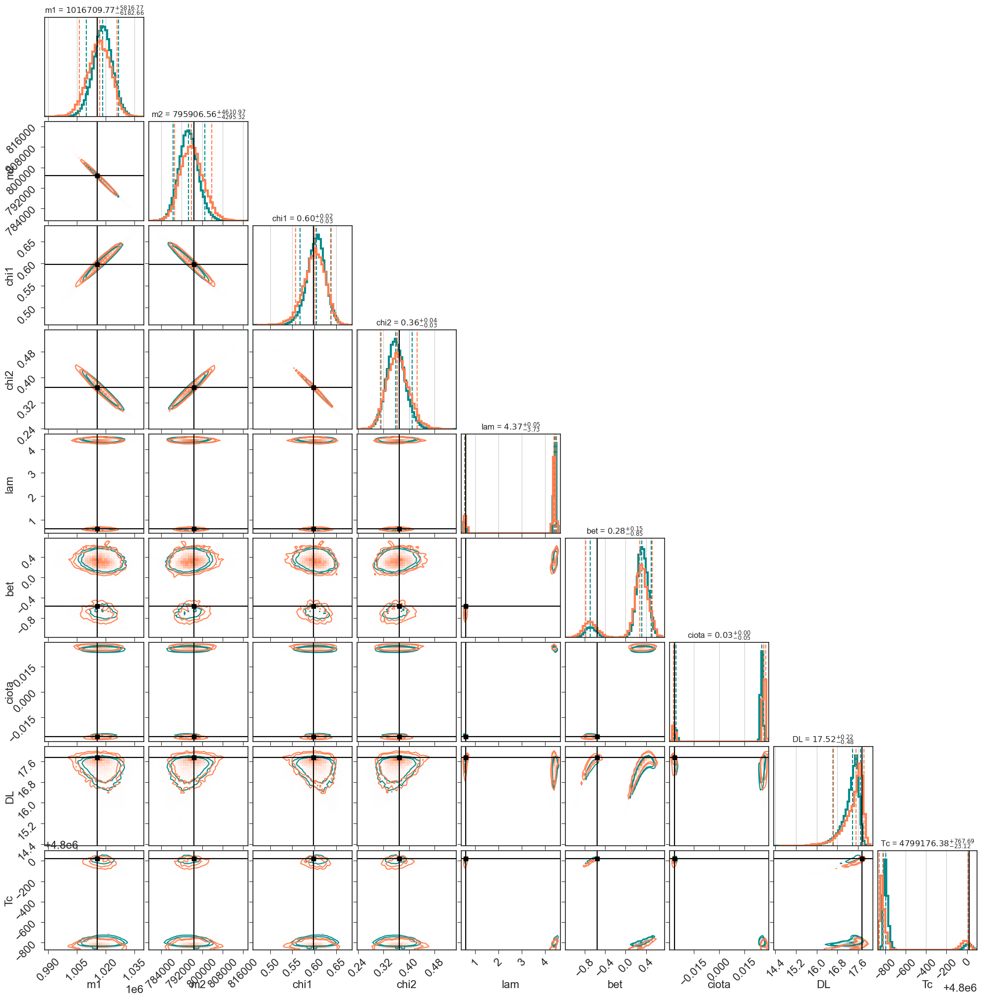

1 MBH008746658


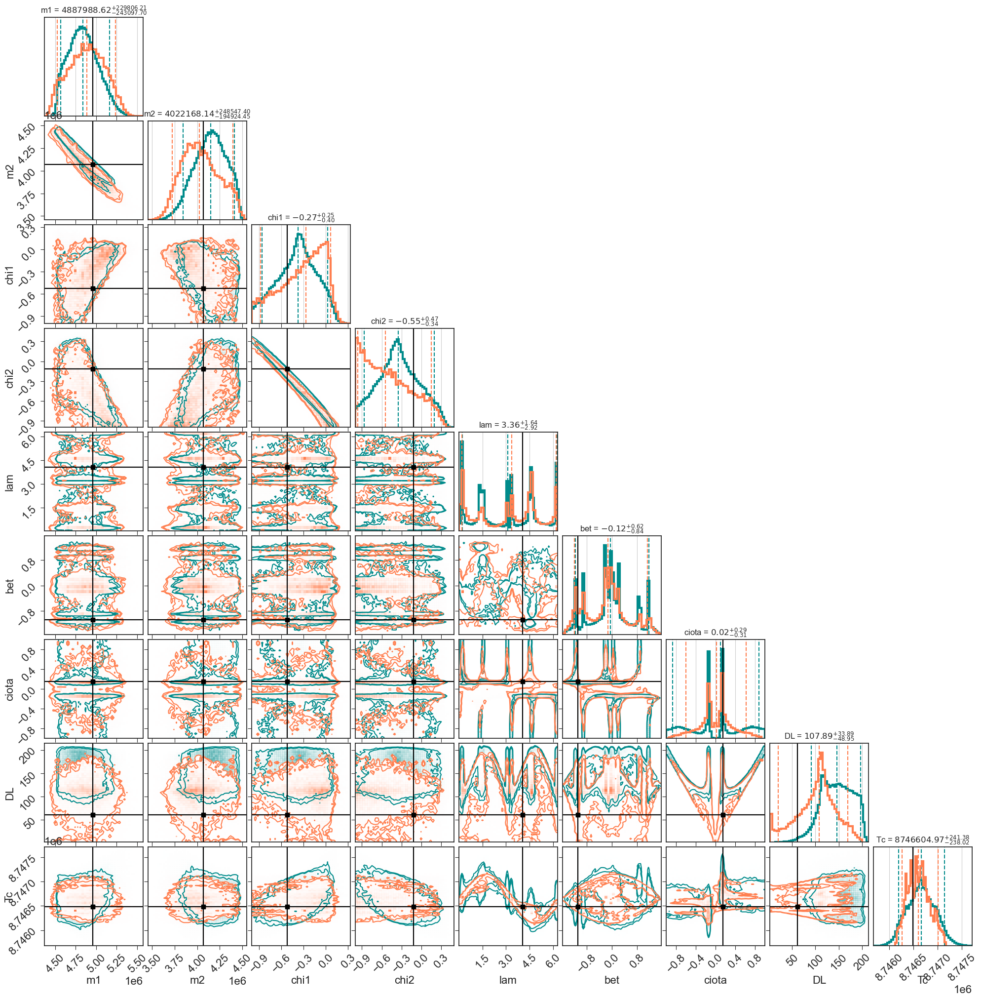

2 MBH011167708


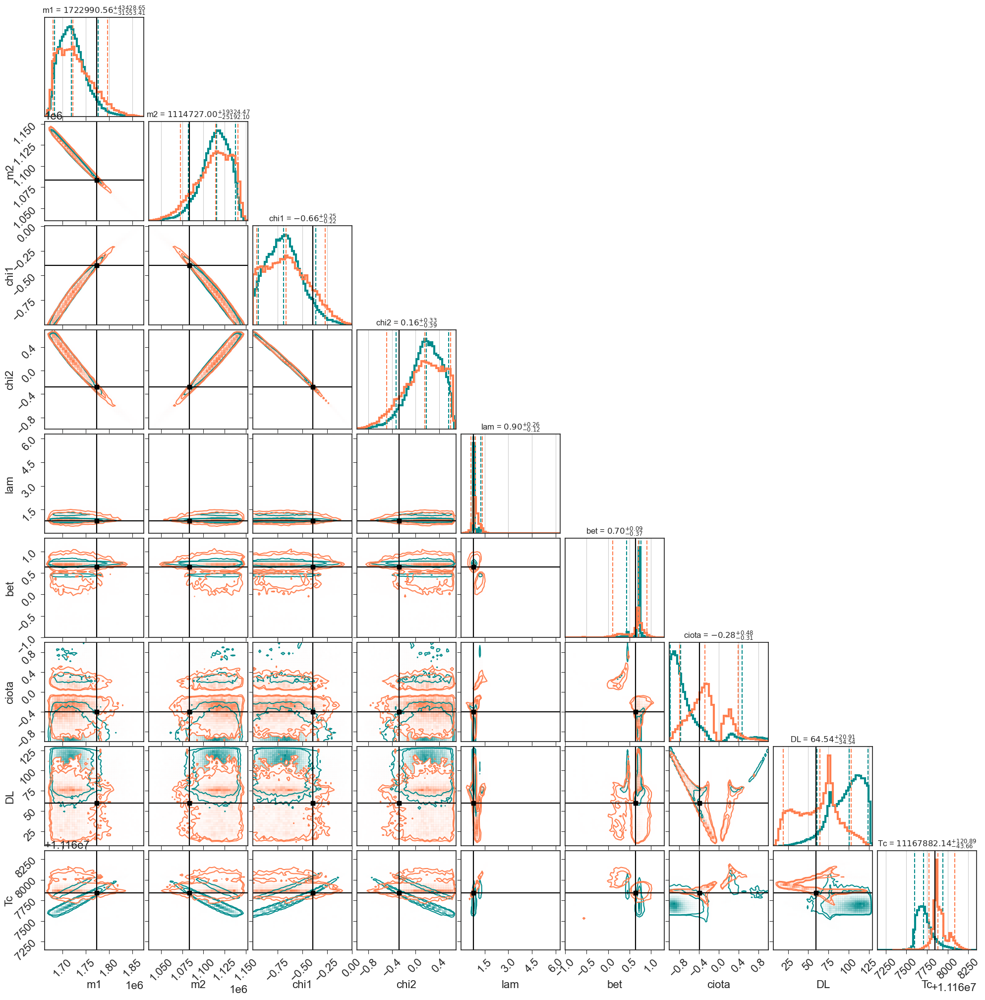

3 MBH011258533


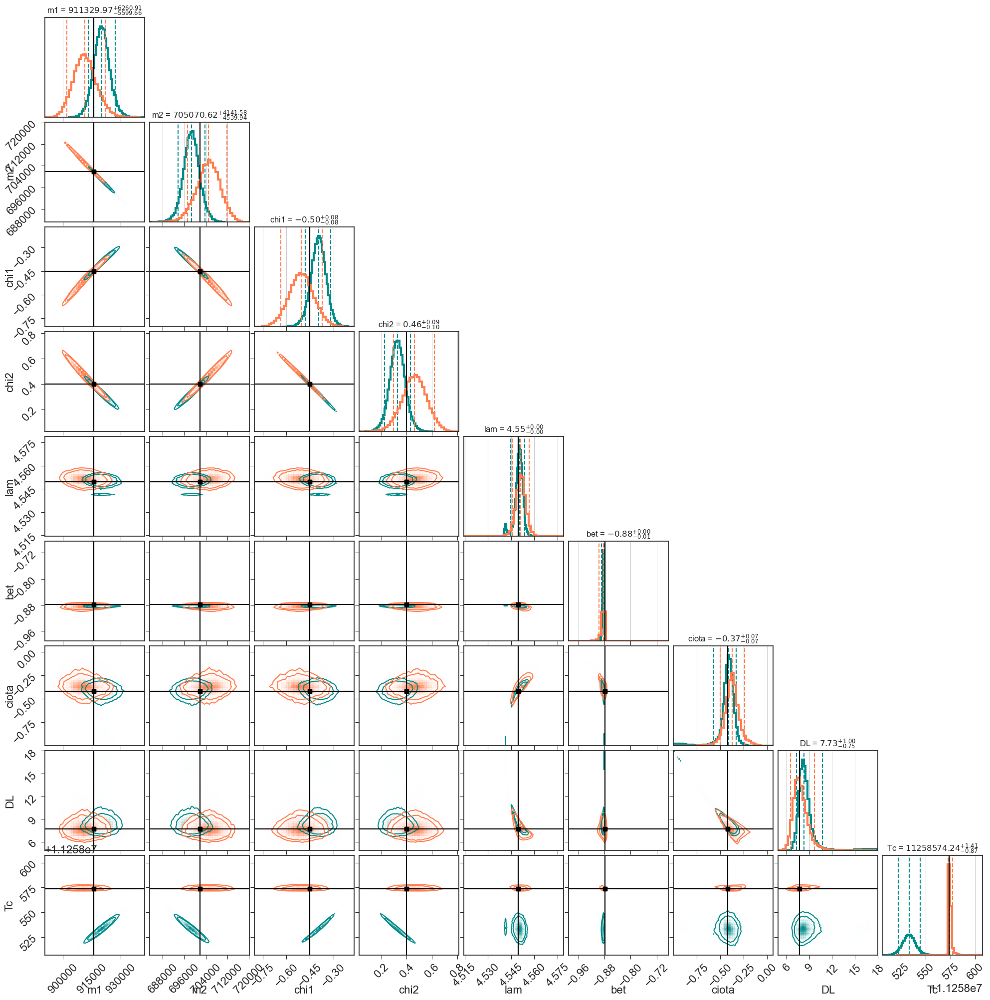

4 MBH011527104


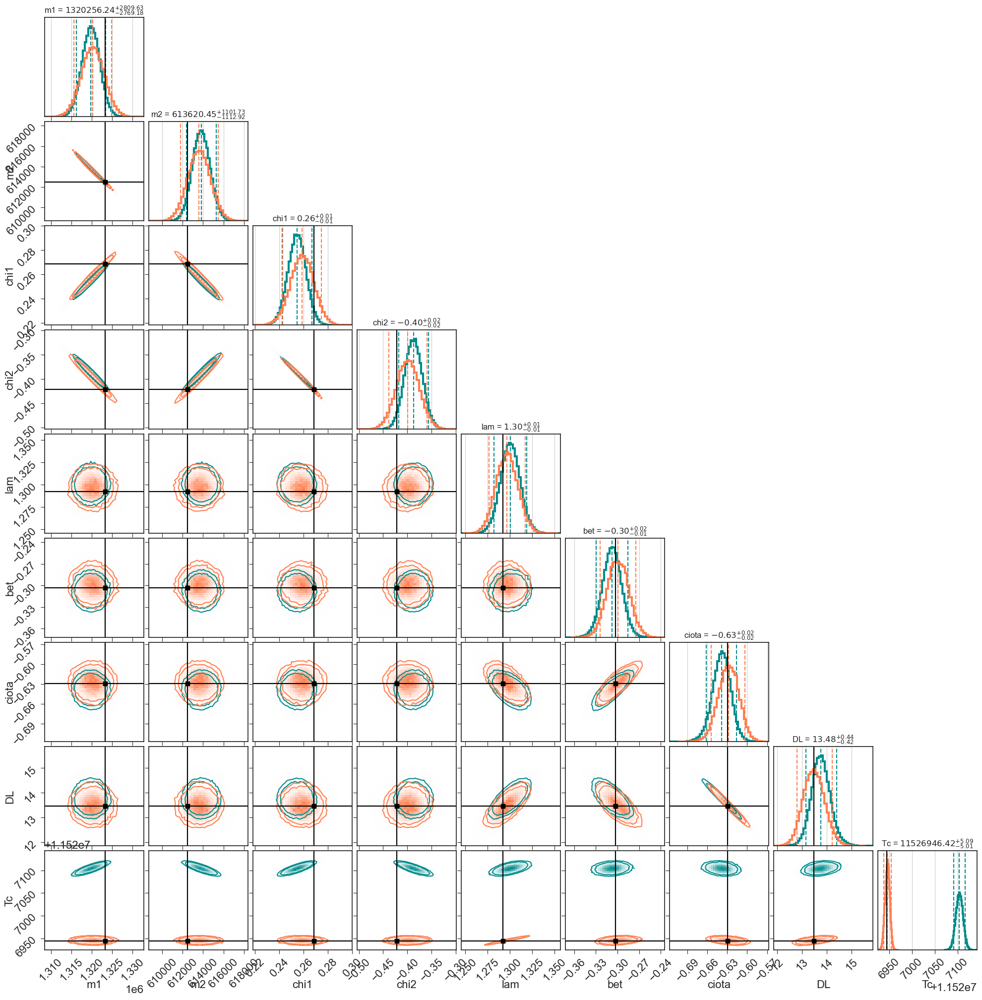

5 MBH011971307


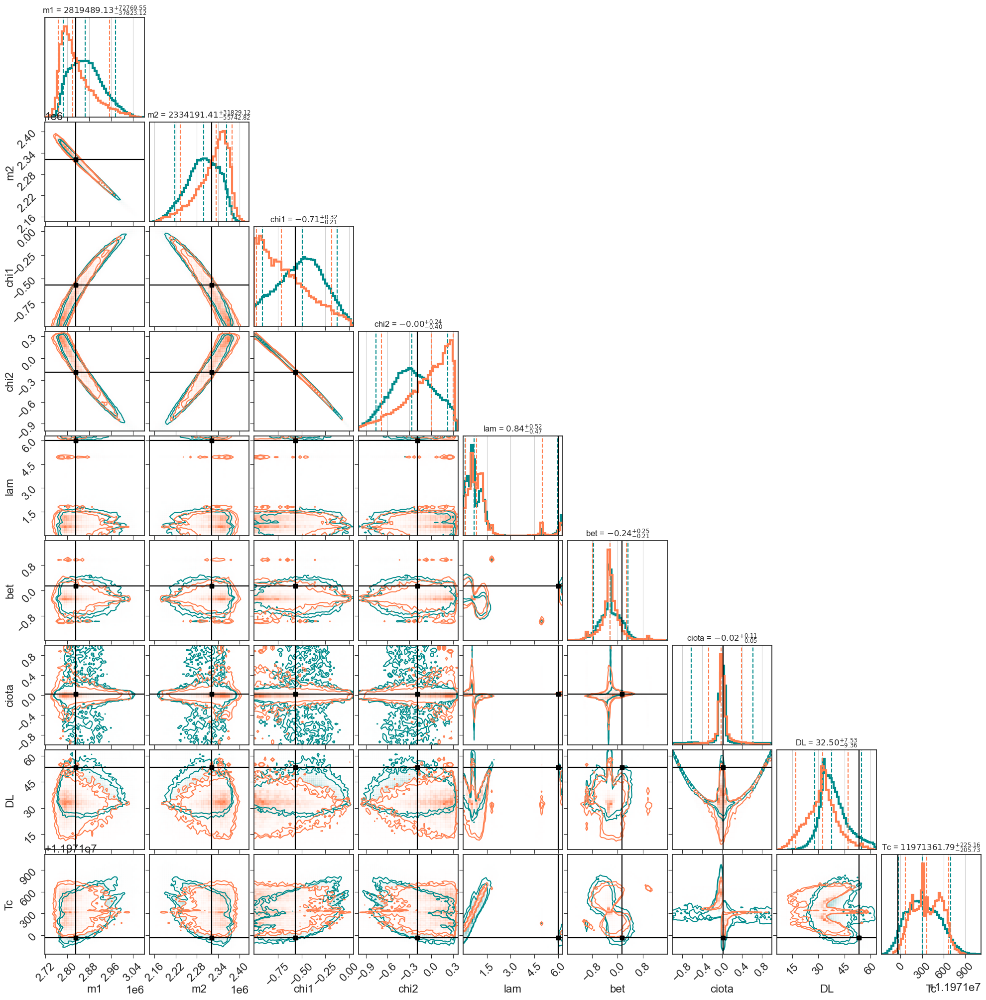

6 MBH013616810


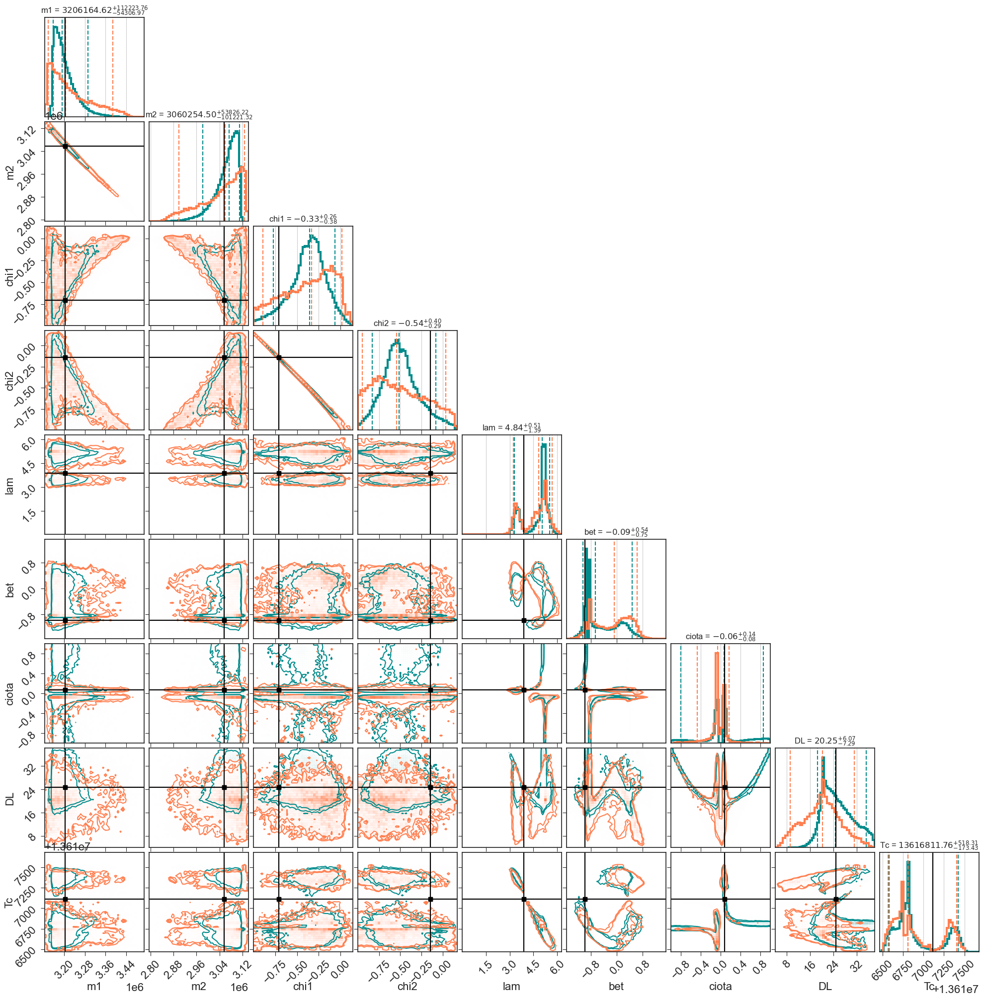

7 MBH016532113


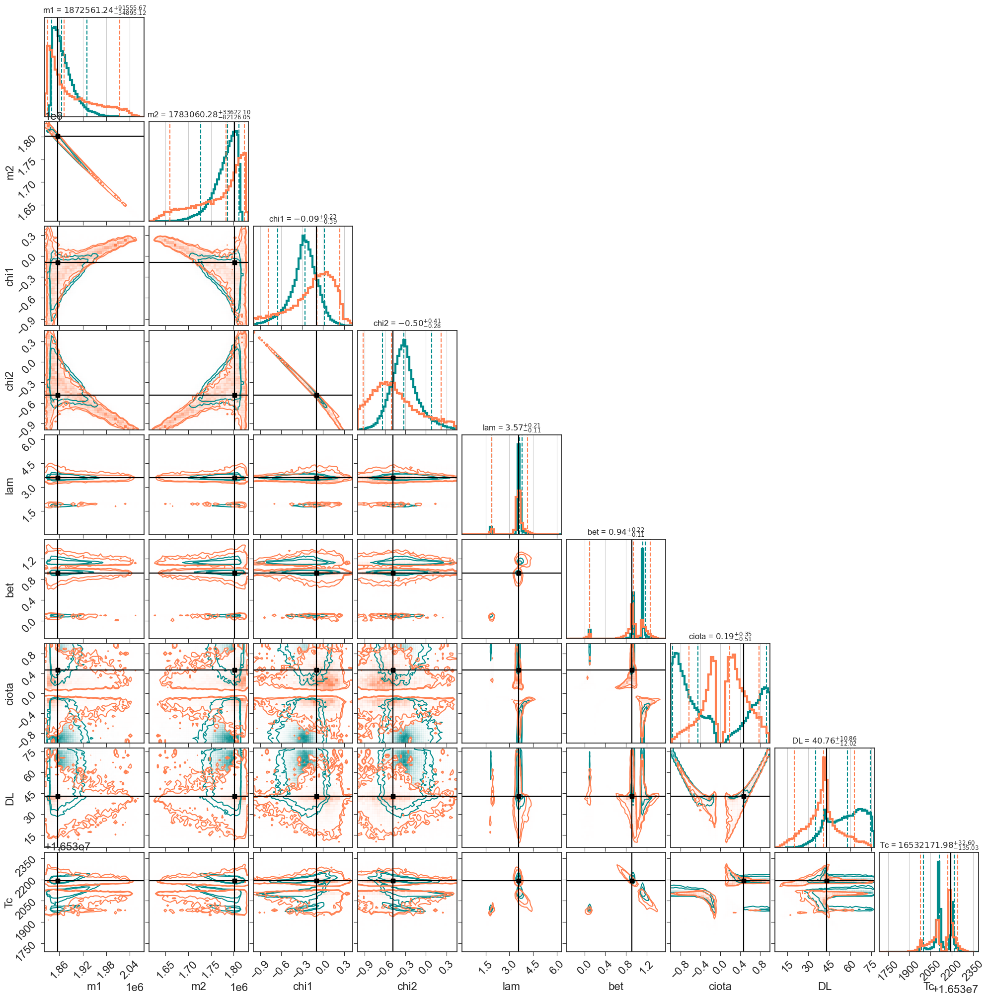

8 MBH017244392


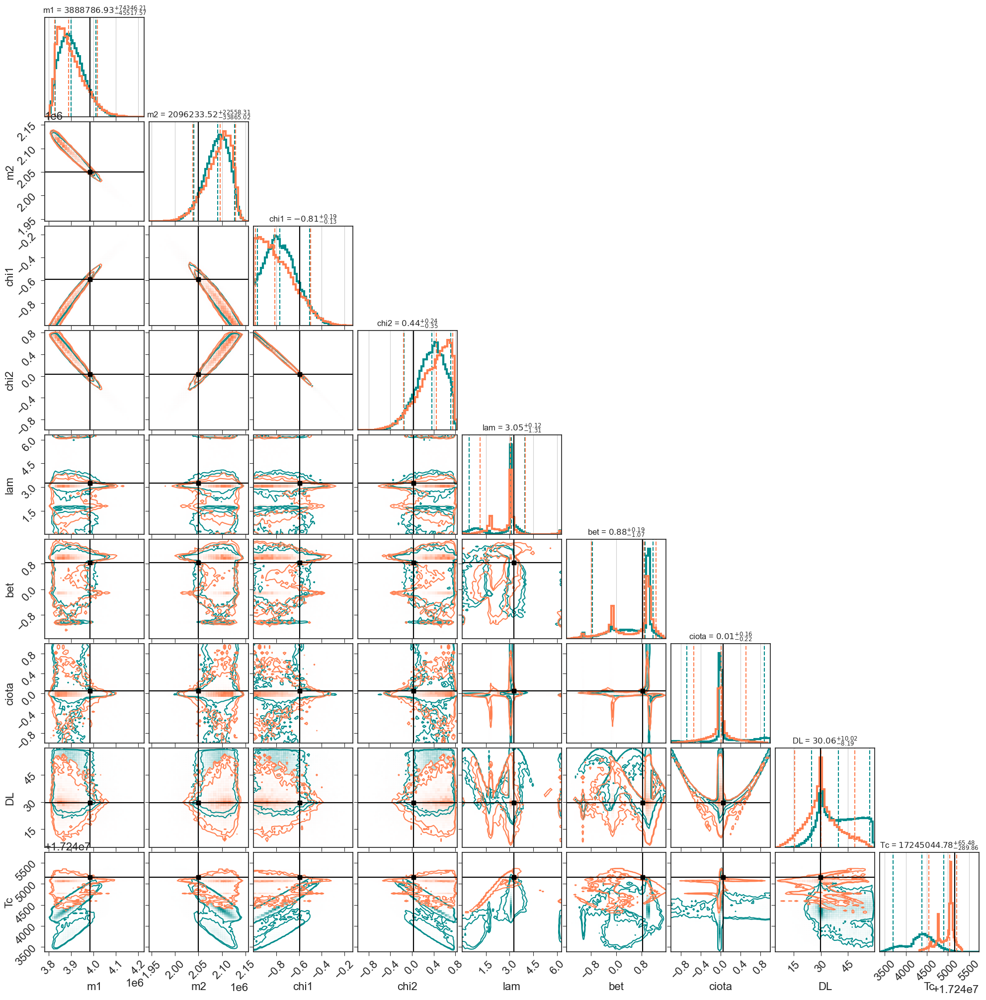

9 MBH018605197


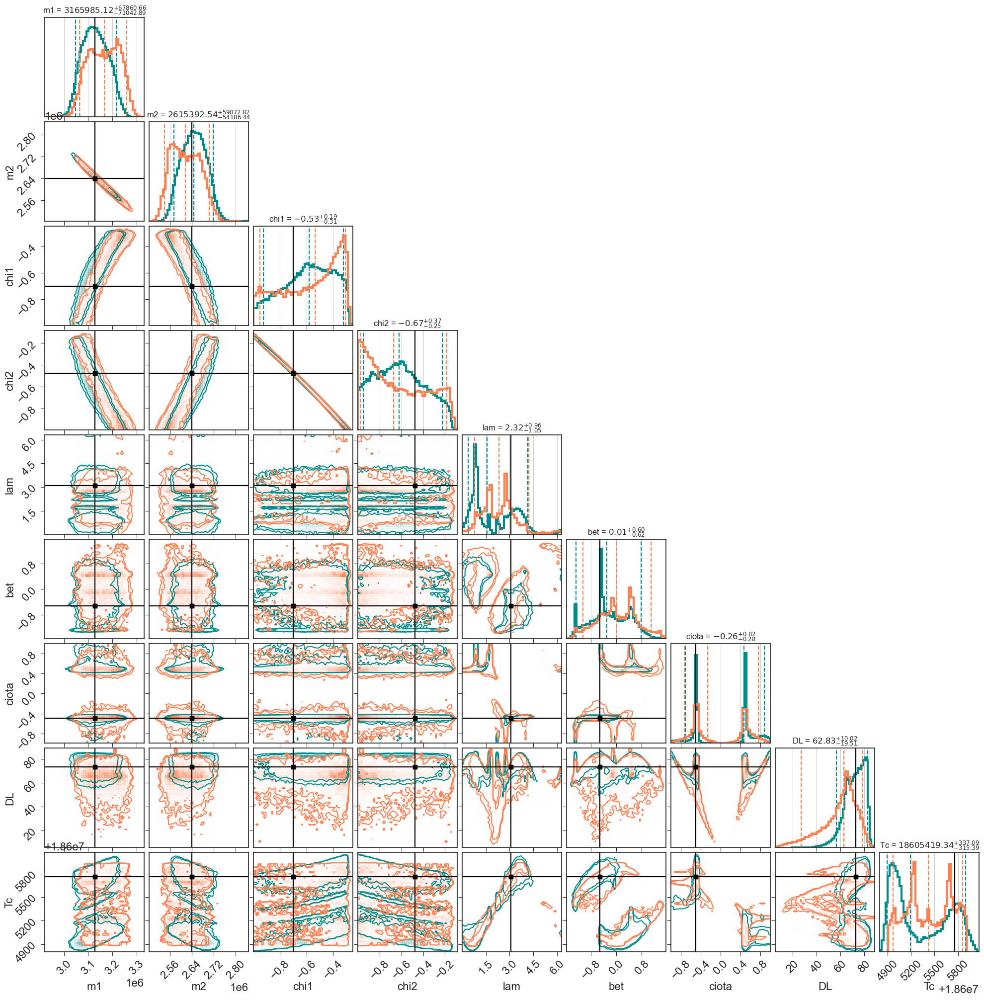

10 MBH020426286


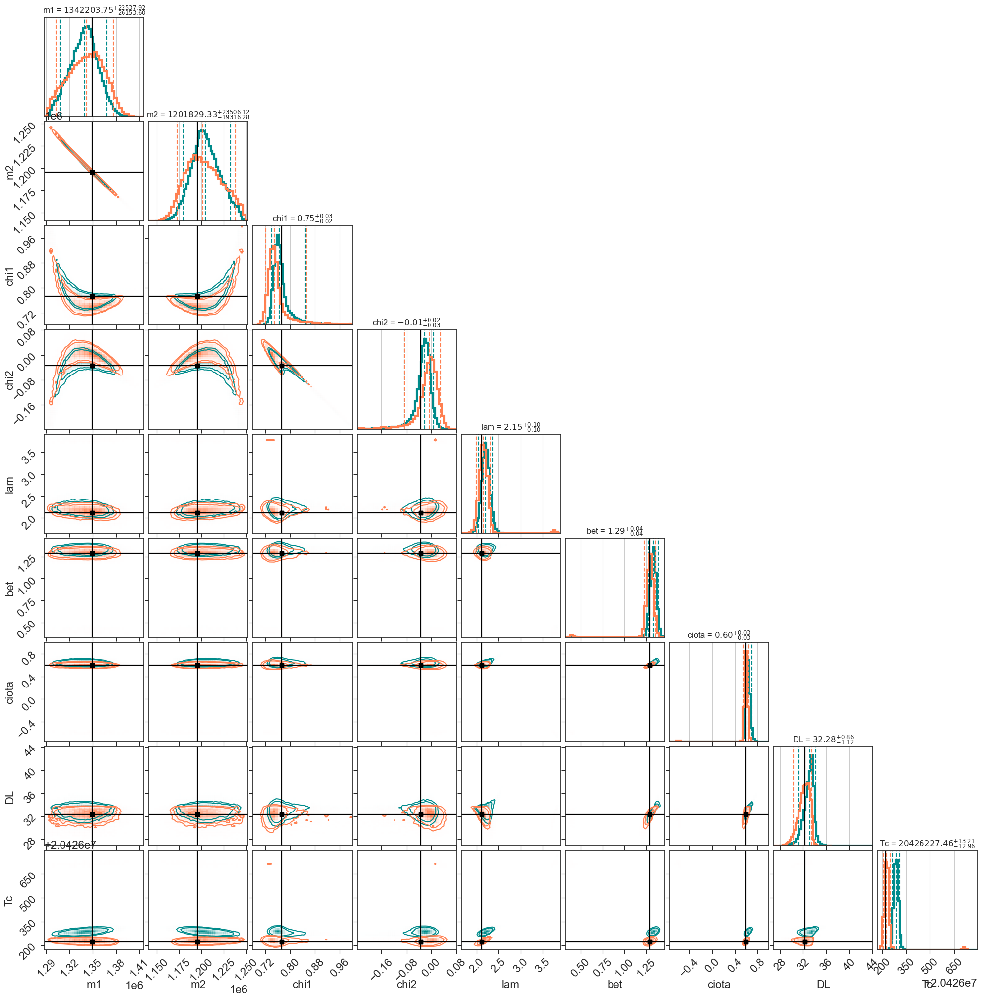

11 MBH022228026


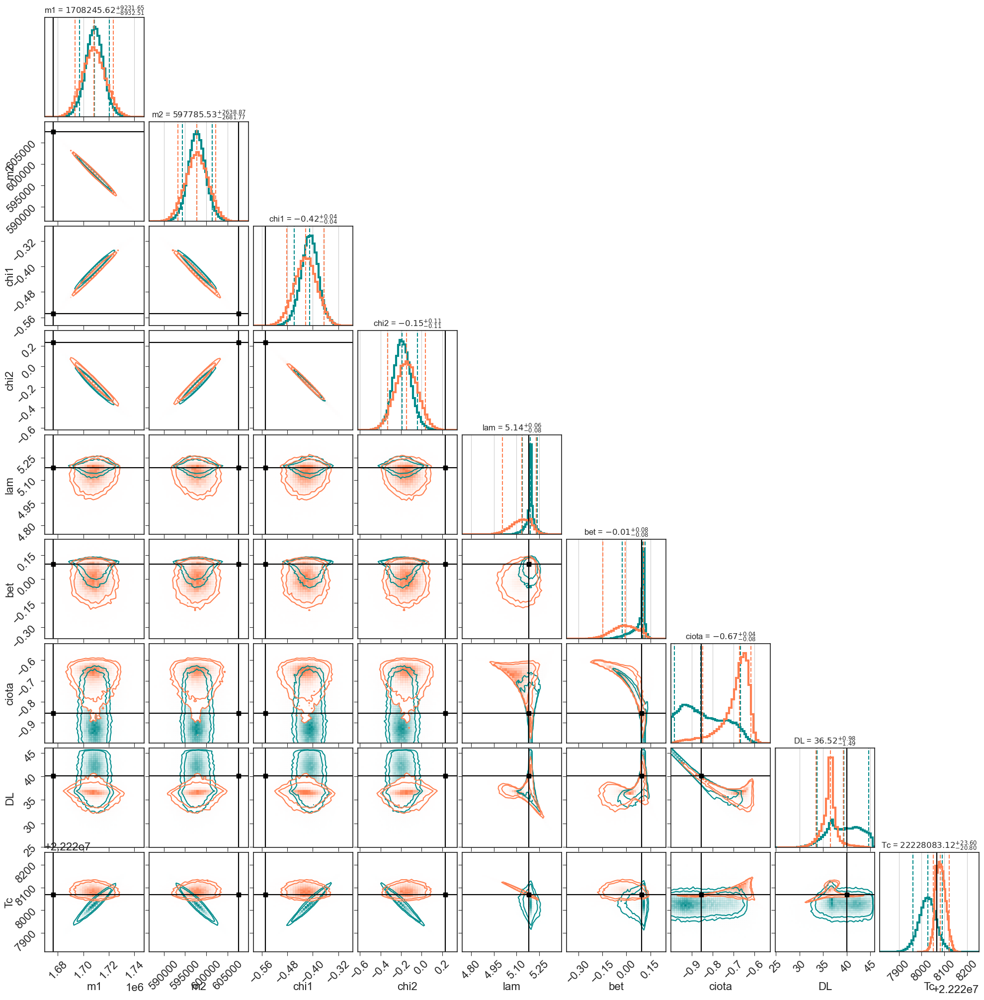

12 MBH023439946


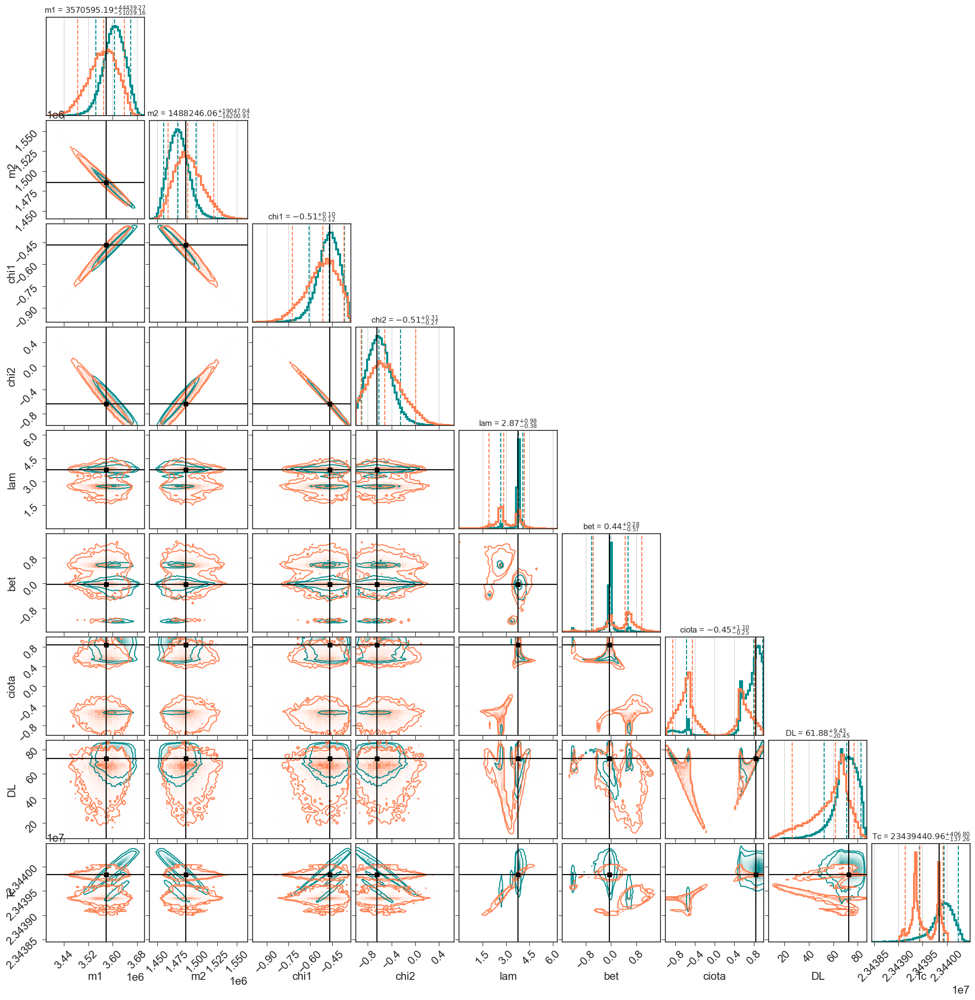

13 MBH024408802


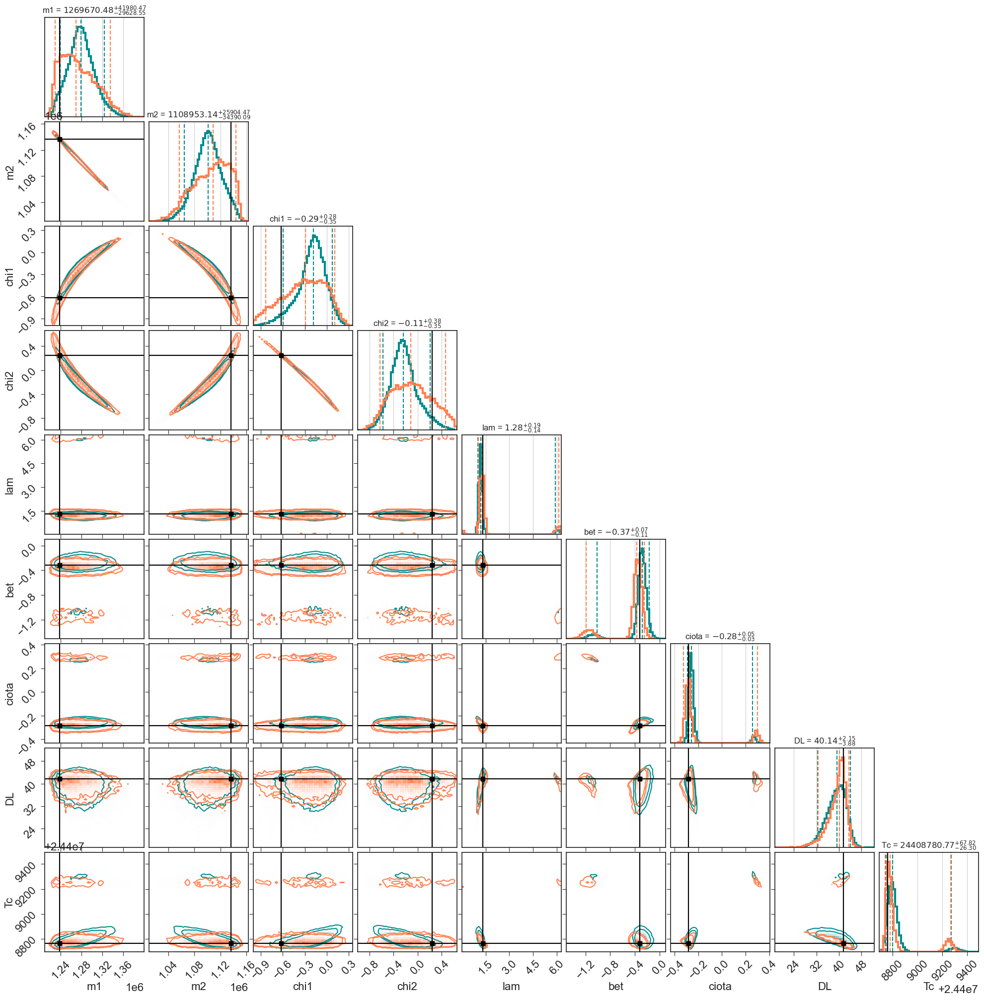

14 MBH029514832


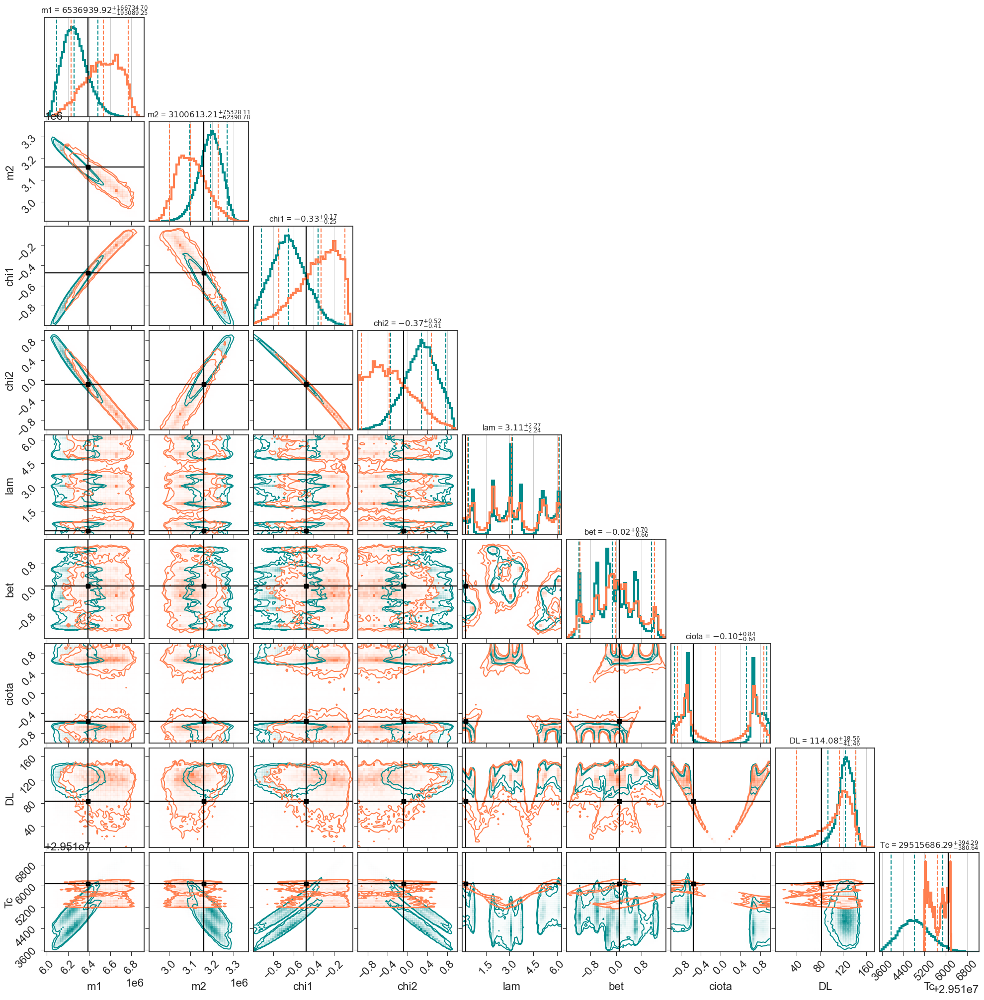

In [12]:
rng  = (0.99, 0.99, 0.99, 0.99, 0.95, 0.99, 0.99, 0.99, 0.99) 
rng  = (0.95, 0.95, 0.95, 0.95, 0.95, 0.95, 0.95, 0.95, 0.95) 

skip = 10000
for ii, nm in enumerate(nms):
    print (ii, nm)
    mbh_samples_attr = mbh_catalog.get_attr_source_samples(nm)
    mbh_samples = mbh_catalog.get_source_samples(nm, mbh_samples_attr)
    mbh_chain = mbh_samples[mbh_parameters].values
    LA, trS =  Rearrange2Common(dat_LA[ii], cats[ii])
    
    fig = corner.corner(mbh_chain[skip::2, :],  bins=50, hist_kwargs={'density':True, 'lw':3}, 
                    plot_datapoints=False, fill_contours=False, quantiles=[0.05, 0.5, 0.95],
                    show_titles=True, color='darkcyan', truths=trS, truth_color='k', use_math_test=True,
                    levels=[0.8, 0.9], title_kwargs={"fontsize": 12}, labels=lbls)#,\
#                    range = rng)

    corner.corner(LA, fig=fig,  bins=40, hist_kwargs={'density':True, 'lw':3}, 
                    plot_datapoints=False, fill_contours=False, quantiles=[0.05, 0.5, 0.95],
                    show_titles=True, color='coral', truths=trS, truth_color='k', use_math_test=True,
                    levels=[0.8, 0.9], title_kwargs={"fontsize": 12}, labels=lbls)#, \
#              range = rng)
    plt.show()

In [13]:
print ('We compute CI and JS-div only for the selected pairs')

lbls = ['m1', 'm2', 'chi1', 'chi2', 'lam', 'bet', 'ciota', 'DL', 'Tc']
check_lbls = [['m1', 'm2'], ['chi1', 'chi2'], ['m1', 'chi1'],['lam', 'bet'], ['ciota', 'DL']] 
check_inds = [[0,1], [2,3], [0,2], [4,5], [6,7]]




We compute CI and JS-div only for the selected pairs


In [14]:
def CI1D(x, xtr):
    sor_x = np.sort(x)
    indx0 = np.argwhere(sor_x >= xtr)[0][0]
    qnt = indx0/len(sor_x)
    alp = 1.0-qnt
    if (alp > 0.5):
        alp = qnt
    
    cix = 1 - 2.*alp
    pltit = False
    if pltit:
        H, xedges = np.histogram(x, bins=200,density=True)
        plt.plot(xedges[1:], np.cumsum(H))
        plt.grid(True)
        plt.show()
        ### check the above number
        cdf = np.cumsum(H)
        cdf_spl = spline(xedges[1:], cdf/cdf[-1])
        print ('check it', 1 - 2.*cdf_spl(xtr))
    return (cix)

def FindCI(x, y, Nbins, Pnt, lbls, pltC=False):
    
    xtr = Pnt[0]
    ytr = Pnt[1]
    H, xedges, yedges = np.histogram2d(x, y, bins=Nbins, density=True)
    dx= np.diff(xedges)[0]
    dy= np.diff(yedges)[0]
    ### find the bin and value of H where true belongs to
    xi = np.where(xedges>= xtr)[0][0]-1
    yi = np.where(yedges>= ytr)[0][0]-1
    
    Hflat = H.flatten()
    cis = []
    iabove = np.argwhere(Hflat >= H[xi, yi] )[:,0]
    cis.append(np.sum(Hflat[iabove])*dx*dy)
    iabove = np.argwhere(Hflat >= H[xi+1, yi+1] )[:,0]
    cis.append(np.sum(Hflat[iabove])*dx*dy)
    iabove = np.argwhere(Hflat >= H[xi+1, yi] )[:,0]
    cis.append(np.sum(Hflat[iabove])*dx*dy)
    iabove = np.argwhere(Hflat >= H[xi, yi+1] )[:,0]
    cis.append(np.sum(Hflat[iabove])*dx*dy)
    
    
    ci = np.mean(np.array(cis))
    ci_m = min(cis)
    ci_p =max(cis)
    if (ci>=0.7 and pltC):
#         pltC = True
#     if (pltC):
        rng = (0.95, 0.95)
#         rng = (0.99, 0.99)
        
        corner.corner(np.array([x, y]).T,  bins=50, hist_kwargs={'density':True, 'lw':3}, 
                    plot_datapoints=False, fill_contours=False, quantiles=[0.05, 0.5, 0.95],
                    show_titles=True, color='darkcyan', truths=Pnt, truth_color='r', use_math_test=True,
                    levels=[ci, 0.9], title_kwargs={"fontsize": 12}, labels=lbls)#,\
#                     range = rng)
        plt.show()
    ### compute marginalized 1d CI
    cix = CI1D(x, xtr)
    ciy = CI1D(y, ytr)
    
    return (np.array([ci, ci_m, ci_p]), cix, ciy)
        

### FIrst the Confidence 1D and 2D intervals

MBH029514832:
0 ['m1', 'm2']


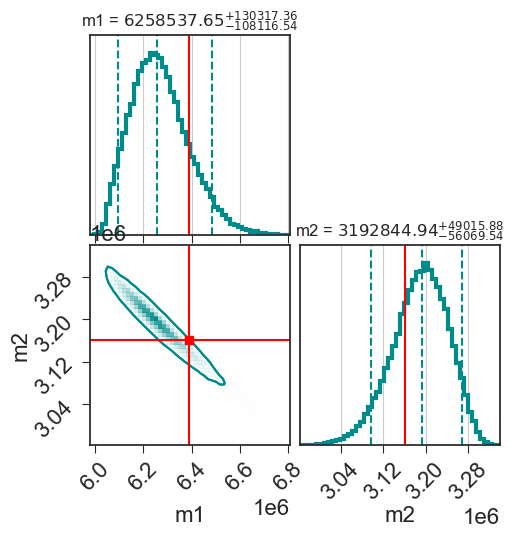

m1 - m2 Neil 2D->0.90(0.87,0.93), 1D-> 0.68,  0.43;  Sylvain 2D-> 0.51(0.37,0.70), 1D-> 0.56,  0.59

1 ['chi1', 'chi2']
chi1 - chi2 Neil 2D->0.62(0.43,0.83), 1D-> 0.68,  0.66;  Sylvain 2D-> 0.41(0.21,0.66), 1D-> 0.46,  0.45

2 ['m1', 'chi1']


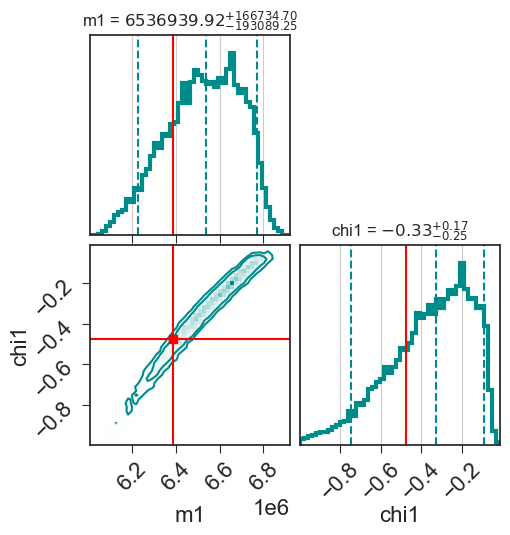

m1 - chi1 Neil 2D->0.44(0.38,0.53), 1D-> 0.68,  0.68;  Sylvain 2D-> 0.73(0.52,0.81), 1D-> 0.56,  0.46

3 ['lam', 'bet']


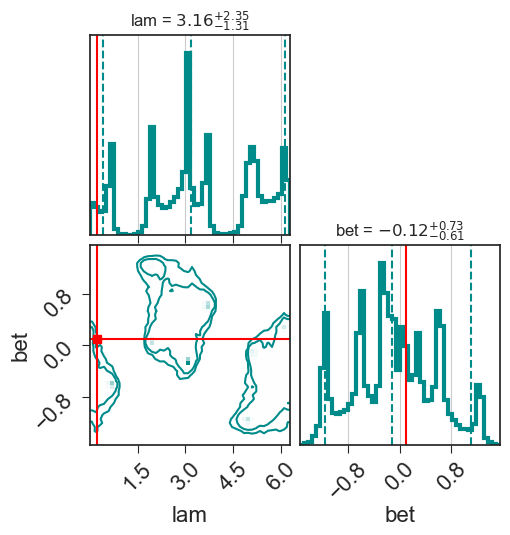

lam - bet Neil 2D->0.97(0.89,1.00), 1D-> 0.94,  0.27;  Sylvain 2D-> 0.69(0.35,0.90), 1D-> 0.94,  0.16

4 ['ciota', 'DL']


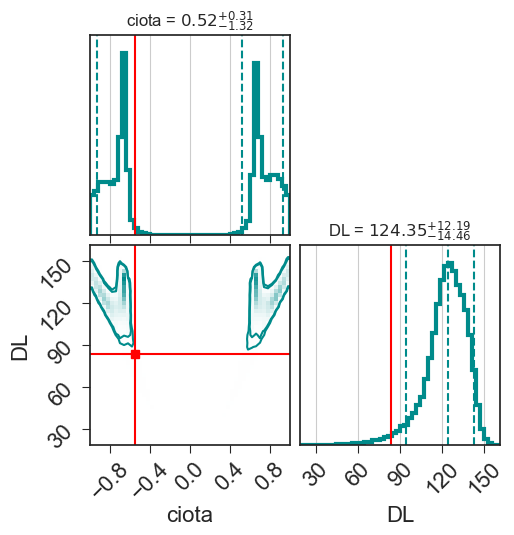

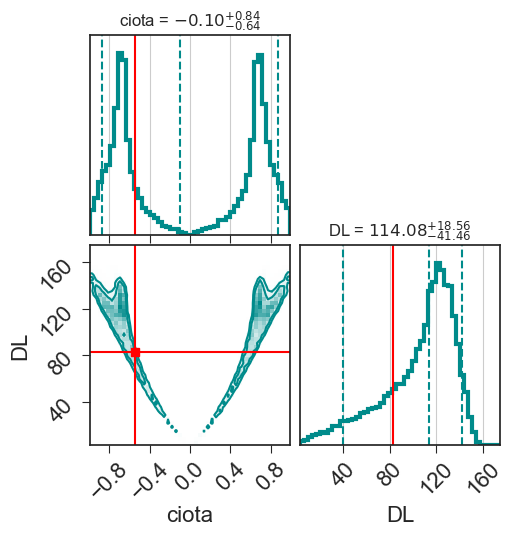

ciota - DL Neil 2D->0.94(0.93,0.96), 1D-> 0.02,  0.95;  Sylvain 2D-> 0.73(0.42,0.98), 1D-> 0.17,  0.57

MBH029514832: 
m1 - m2 Neil 2D->0.90(0.87,0.93), 1D-> 0.68,  0.43;  Sylvain 2D-> 0.51(0.37,0.70), 1D-> 0.56,  0.59
chi1 - chi2 Neil 2D->0.62(0.43,0.83), 1D-> 0.68,  0.66;  Sylvain 2D-> 0.41(0.21,0.66), 1D-> 0.46,  0.45
m1 - chi1 Neil 2D->0.44(0.38,0.53), 1D-> 0.68,  0.68;  Sylvain 2D-> 0.73(0.52,0.81), 1D-> 0.56,  0.46
lam - bet Neil 2D->0.97(0.89,1.00), 1D-> 0.94,  0.27;  Sylvain 2D-> 0.69(0.35,0.90), 1D-> 0.94,  0.16
ciota - DL Neil 2D->0.94(0.93,0.96), 1D-> 0.02,  0.95;  Sylvain 2D-> 0.73(0.42,0.98), 1D-> 0.17,  0.57



In [15]:
# ci = FindCI(m1S, DL, 200, [m1Tr, DLTr], [r'$m_1$', r'$D_L$'], pltC=True) 
indS = 14
LA, trS =  Rearrange2Common(dat_LA[indS], cats[indS])
nm = nms[indS]
print (nm + ':')
mbh_samples_attr = mbh_catalog.get_attr_source_samples(nm)
mbh_samples = mbh_catalog.get_source_samples(nm, mbh_samples_attr)
mbh_chain = mbh_samples[mbh_parameters].values

report = nm + ': \n'
for ii, lbl in enumerate(check_lbls):
    rec = ''
    print (ii, lbl)
#     print ('Neil')
    i1, i2 = check_inds[ii]
    x1 = mbh_chain[skip::2, i1]
    x2 = mbh_chain[skip::2, i2]
    ci = FindCI(x1, x2, 150, [trS[i1], trS[i2]], lbl, pltC=True) 
#     print ('CI:', '2D -> ',ci[0][0], '1D->', ci[1], ci[2])
    rec += lbl[0] + " - " + lbl[1] + f' Neil 2D->{ci[0][0]:.2f}({ci[0][1]:.2f},{ci[0][2]:.2f}), 1D->{ci[1]: .2f}, {ci[2]: .2f}'
#     print ('Sylvain')
    x1 = LA[:, i1]
    x2 = LA[:, i2]
    ci = FindCI(x1, x2, 150, [trS[i1], trS[i2]], lbl, pltC=True) 
#     print ('CI:', '2D -> ',ci[0][0], '1D->', ci[1], ci[2])
    rec +=  f';  Sylvain 2D->{ci[0][0]: .2f}({ci[0][1]:.2f},{ci[0][2]:.2f}), 1D->{ci[1]: .2f}, {ci[2]: .2f}' + '\n'
    report += rec
    
    print (rec)

print (report)

In [16]:
report= ''
for indS in range(len(nms)):
    LA, trS =  Rearrange2Common(dat_LA[indS], cats[indS])
    nm = nms[indS]
    print (nm + ':')
    mbh_samples_attr = mbh_catalog.get_attr_source_samples(nm)
    mbh_samples = mbh_catalog.get_source_samples(nm, mbh_samples_attr)
    mbh_chain = mbh_samples[mbh_parameters].values

    report += nm + ': \n'
    for ii, lbl in enumerate(check_lbls):
        rec = ''
#         print (ii, lbl)
#     print ('Neil')
        i1, i2 = check_inds[ii]
        x1 = mbh_chain[skip::2, i1]
        x2 = mbh_chain[skip::2, i2]
        ci = FindCI(x1, x2, 150, [trS[i1], trS[i2]], lbl, pltC=False) 
    #     print ('CI:', '2D -> ',ci[0][0], '1D->', ci[1], ci[2])
        rec += lbl[0] + " - " + lbl[1] + f' Neil 2D->{ci[0][0]:.2f}({ci[0][1]:.2f},{ci[0][2]:.2f}), 1D->{ci[1]: .2f}, {ci[2]: .2f}'
    #     print ('Sylvain')
        x1 = LA[:, i1]
        x2 = LA[:, i2]
        ci = FindCI(x1, x2, 150, [trS[i1], trS[i2]], lbl, pltC=False) 
    #     print ('CI:', '2D -> ',ci[0][0], '1D->', ci[1], ci[2])
        rec +=  f';  Sylvain 2D->{ci[0][0]: .2f}({ci[0][1]:.2f},{ci[0][2]:.2f}), 1D->{ci[1]: .2f}, {ci[2]: .2f}' + '\n'
        report += rec
#     print (rec)

print (report)

MBH004799207:
MBH008746658:
MBH011167708:
MBH011258533:
MBH011527104:
MBH011971307:
MBH013616810:
MBH016532113:
MBH017244392:
MBH018605197:
MBH020426286:
MBH022228026:
MBH023439946:
MBH024408802:
MBH029514832:
MBH004799207: 
m1 - m2 Neil 2D->0.83(0.37,1.00), 1D-> 0.44,  0.45;  Sylvain 2D-> 0.76(0.07,1.00), 1D-> 0.16,  0.17
chi1 - chi2 Neil 2D->0.56(0.28,0.99), 1D-> 0.27,  0.27;  Sylvain 2D-> 0.37(0.06,0.91), 1D-> 0.13,  0.12
m1 - chi1 Neil 2D->0.50(0.35,0.66), 1D-> 0.44,  0.27;  Sylvain 2D-> 0.14(0.07,0.24), 1D-> 0.16,  0.13
lam - bet Neil 2D->0.94(0.89,0.98), 1D-> 0.79,  0.82;  Sylvain 2D-> 0.82(0.80,0.84), 1D-> 0.79,  0.68
ciota - DL Neil 2D->0.97(0.92,1.00), 1D-> 0.98,  0.97;  Sylvain 2D-> 0.84(0.65,0.99), 1D-> 0.72,  0.72
MBH008746658: 
m1 - m2 Neil 2D->0.47(0.40,0.55), 1D-> 0.46,  0.34;  Sylvain 2D-> 0.90(0.83,0.94), 1D-> 0.22,  0.15
chi1 - chi2 Neil 2D->0.85(0.74,0.95), 1D-> 0.39,  0.50;  Sylvain 2D-> 1.00(1.00,1.00), 1D-> 0.48,  0.63
m1 - chi1 Neil 2D->0.56(0.26,0.80), 1D-> 0.46

### Let me try to make violin plots

dealing with  ['m1', 'm2']


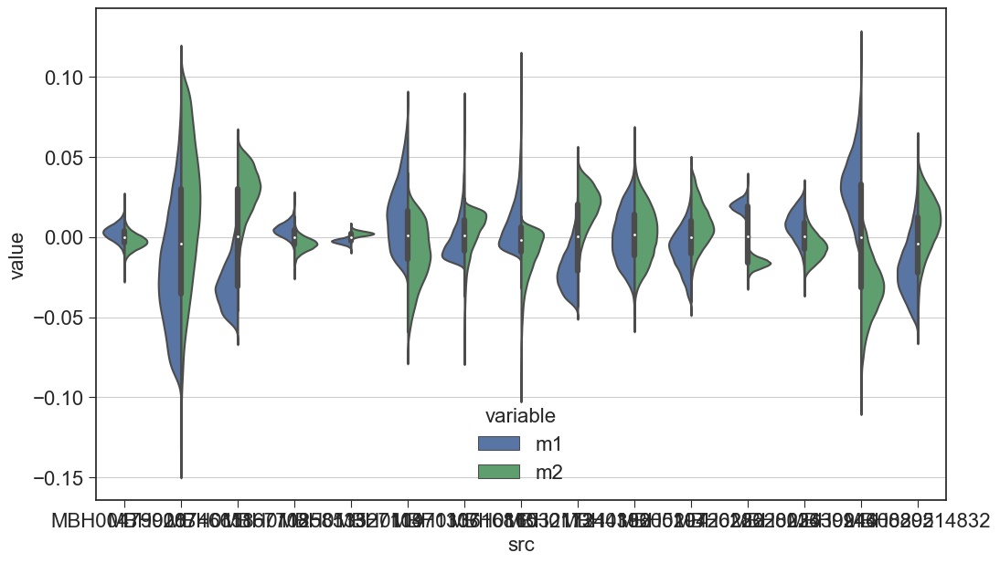

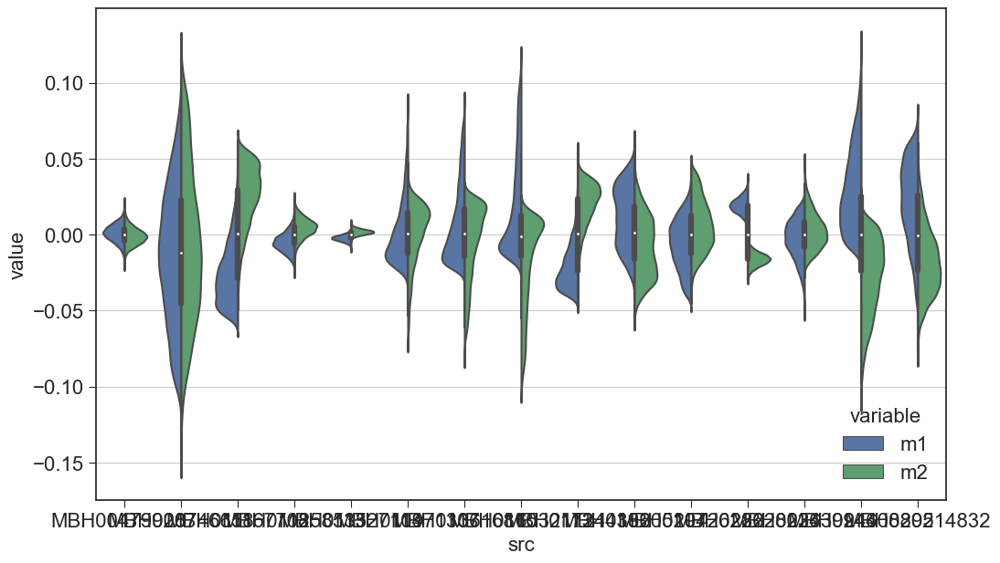

In [17]:
import seaborn as sns
import pandas as pd

pair = 0
def Hist1Dviolin(pair, frac=True):

    print ('dealing with ', check_lbls[pair])
    i1, i2 = check_inds[pair]

    alN = pd.DataFrame()
    alS = pd.DataFrame()
    for inm in range(len(nms)):
        LA, trS =  Rearrange2Common(dat_LA[inm], cats[inm])
        nm = nms[inm]
        mbh_samples_attr = mbh_catalog.get_attr_source_samples(nm)
        mbh_samples = mbh_catalog.get_source_samples(nm, mbh_samples_attr)
        mbh_chain = mbh_samples[mbh_parameters].values
    
        x1 = (mbh_chain[skip::10, i1] - trS[i1])
        x2 = (mbh_chain[skip::10, i2] - trS[i2])
        if frac:
            x1 = x1/trS[i1]
            x2 = x2/trS[i2]
        tryN = pd.DataFrame({check_lbls[pair][0]:x1, check_lbls[pair][1]:x2})
        tryN = tryN.melt()
        tryN['src'] = nms[inm]
        alN = pd.concat([alN, tryN], axis=0)
        
        y1 = (LA[::10, i1] - trS[i1])
        y2 = (LA[::10, i2] - trS[i2])
        if frac:
            y1 = y1/trS[i1]
            y2 = y2/trS[i2]
        tryS = pd.DataFrame({check_lbls[pair][0]:y1, check_lbls[pair][1]:y2})
        tryS = tryS.melt()
        tryS['src'] = nms[inm]
        alS = pd.concat([alS, tryS], axis=0)
    
    return (alN, alS)

alN, alS = Hist1Dviolin(0, frac=True)

sns.violinplot(data=alN,  y='value', split=True, hue='variable', x='src')
plt.show()
sns.violinplot(data=alS,  y='value', split=True, hue='variable', x='src')
plt.show()
# sns.violinplot(data=tryS,  y='value', split=True, hue='variable', x='src')

['3167.1', '303.4', '519.8', '2481.7', '4103.9', '1076.9', '1736.9', '952.1', '913.8', '1159.5', '2637.7', '1538.7', '964.8', '1129.3', '590.5']


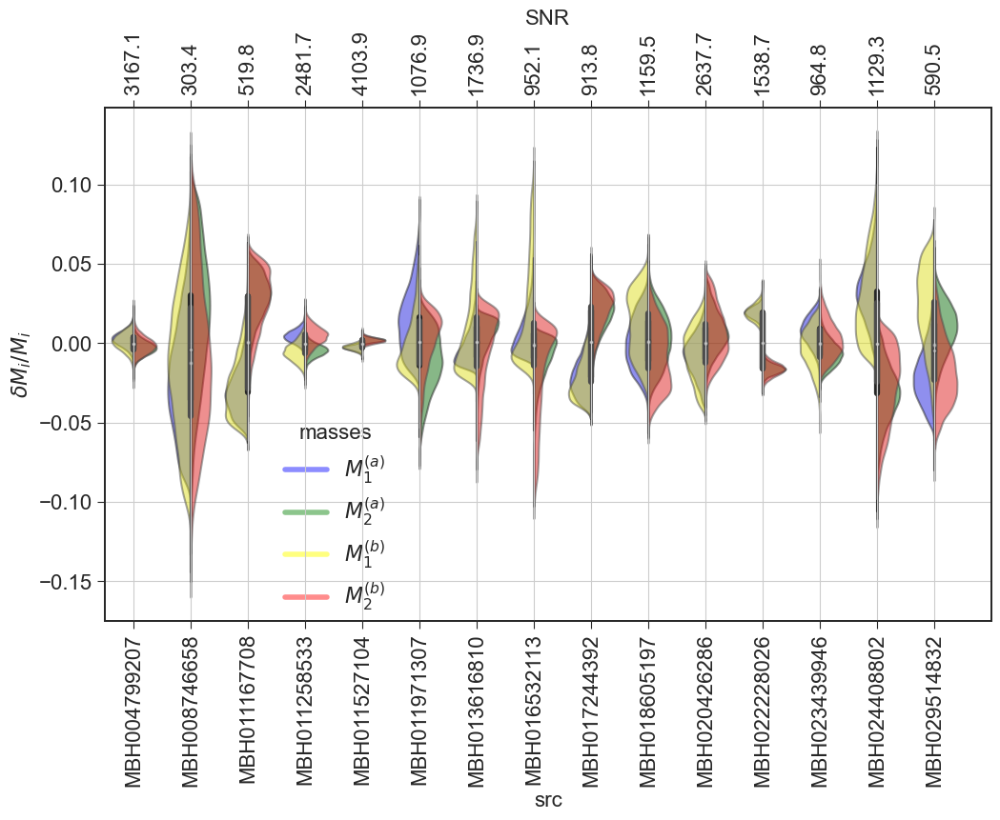

In [78]:
sns.color_palette('pastel')

SNlbl = []
for SN in SNRs:
#     SN = str(SN:5.1f)
    SNlbl.append("{:5.1f}".format(SN))
print (SNlbl)
# print (f'{SNR:5.1f}' for SNR in SNRs)

fig, ax = plt.subplots()

sns.violinplot(data=alN,  y='value', split=True, hue='variable', x='src', ax=ax, 
               palette={'m1':'blue', 'm2':'green'})
sns.violinplot(data=alS,  y='value', split=True, hue='variable', x='src', ax=ax, 
               palette={'m1':'yellow', 'm2':'red'})

for violin in ax.collections:
    violin.set_alpha(0.5)

ax.tick_params(axis='x', rotation=90)
ax.set_ylabel(r'$\delta M_i/M_i$', 
               fontweight ='bold')

# , 'green', 'yellow', 'red']
from matplotlib.lines import Line2D
custom_lines = [
     Line2D([0], [0], color='blue', lw=4, alpha=0.45),
     Line2D([0], [0], color='green', lw=4, alpha=0.45),
     Line2D([0], [0], color='yellow', lw=4, alpha=0.5),
     Line2D([0], [0], color='red', lw=4, alpha=0.45)
]

ax.legend(
    custom_lines, 
    [r'$M_1^{(a)}$', r'$M_2^{(a)}$', r'$M_1^{(b)}$', r'$M_2^{(b)}$'], 
    title="masses", bbox_to_anchor=(0.26, 0.42))
# plt.grid(True)

# print ('stas', ax.get_xticks())
# print (np.linspace(0.13, 14, 15))
ax.set_xlim([-0.5, 15])
ax2 = ax.twiny()
ax2.set_xlabel('SNR')
# ax2.set_xticks(ax.get_xticks())
ax2.set_xticks(np.linspace(0.0, 14., 15))
ax2.set_xticklabels(SNlbl)
ax2.tick_params(axis='x', rotation=90)
ax2.set_xlim([-0.5, 15])
# plt.show()
plt.savefig('SangriaMBHBs1DviolMs.pdf', bbox_inches='tight')

dealing with  ['chi1', 'chi2']


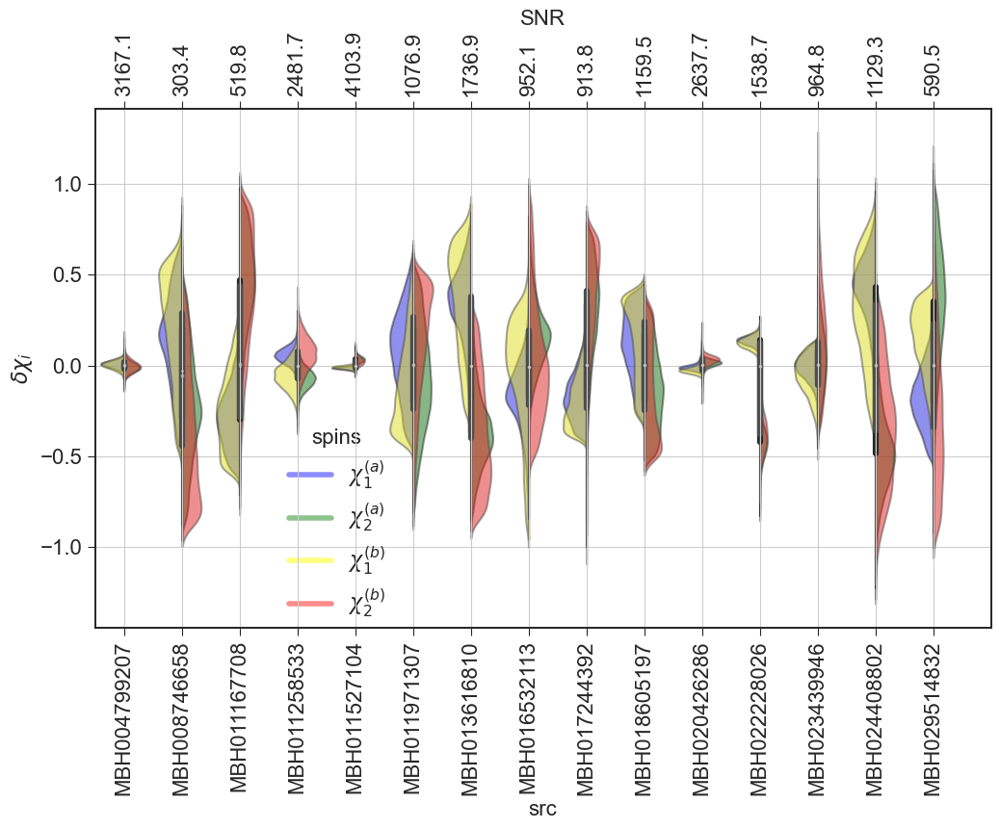

In [79]:
alNs, alSs = Hist1Dviolin(1, frac=False)

sns.color_palette('pastel')

fig, ax = plt.subplots()

sns.violinplot(data=alNs,  y='value', split=True, hue='variable', x='src', ax=ax, 
               palette={'chi1':'blue', 'chi2':'green'})

sns.violinplot(data=alSs,  y='value', split=True, hue='variable', x='src', ax=ax, 
               palette={'chi1':'yellow', 'chi2':'red'})

for violin in ax.collections:
    violin.set_alpha(0.5)

ax.tick_params(axis='x', rotation=90)
ax.set_ylabel(r'$\delta \chi_i$', 
               fontweight ='bold')

# , 'green', 'yellow', 'red']
from matplotlib.lines import Line2D
custom_lines = [
    Line2D([0], [0], color='blue', lw=4, alpha=0.45),
     Line2D([0], [0], color='green', lw=4, alpha=0.45),
     Line2D([0], [0], color='yellow', lw=4, alpha=0.5),
     Line2D([0], [0], color='red', lw=4, alpha=0.45)
]

ax.legend(
    custom_lines, 
    [r'$\chi_1^{(a)}$', r'$\chi_2^{(a)}$', r'$\chi_1^{(b)}$', r'$\chi_2^{(b)}$'], 
    title="spins", bbox_to_anchor=(0.27, 0.42))
# plt.grid(True)
# plt.show()
#  bbox_to_
ax.set_xlim([-0.5, 15])
ax2 = ax.twiny()
ax2.set_xlabel('SNR')
# ax2.set_xticks(ax.get_xticks())
ax2.set_xticks(np.linspace(0.0, 14., 15))
ax2.set_xticklabels(SNlbl)
ax2.tick_params(axis='x', rotation=90)
ax2.set_xlim([-0.5, 15])

plt.savefig('SangriaMBHBs1DviolSpins.pdf', bbox_inches='tight')

### Computing Jensen-Shannon divergence 

In [20]:
def JSD1d(x, y, minsz=20000):
    kerP1d = stats.gaussian_kde(x)
    kerQ1d = stats.gaussian_kde(y)
    
    sz = min(len(x), len(y), minsz)
    pnts = np.concatenate((np.random.choice(x, sz, replace=False), \
                          np.random.choice(y, sz, replace=False)) )
    Pis = kerP1d(pnts)
    Qis =  kerQ1d(pnts)
    Pis = np.clip(Pis, 1.e-30, None)
    Qis = np.clip(Qis, 1.e-30, None)
    
    PisN = Pis/np.sum(Pis)
    QisN = Qis/np.sum(Qis)
    MisN = 0.5*(PisN + QisN)
    
    KL = np.sum(PisN * np.log(PisN/QisN))
    JS = 0.5*(np.sum(PisN * np.log(PisN/MisN)) + np.sum(QisN * np.log(QisN/MisN)))
    
    return (KL, JS)
    

def JSD2d(P, Q, minsz=20000):
    kerP = stats.gaussian_kde(P)
    kerQ = stats.gaussian_kde(Q)
    
    x1, x2 = P
    y1, y2 = Q
    sz = min(len(x1), len(y1), minsz)
#     print ('min size', sz)
    ind_x = np.random.randint(0, high=len(x1), size=sz)
    ind_y = np.random.randint(0, high=len(y1), size=sz)
    x1c = np.concatenate((x1[ind_x], y1[ind_y]))
    x2c = np.concatenate((x2[ind_x], y2[ind_y]))
#     print ('data size', x1c.shape)
    pnts = np.vstack([x1c, x2c])
    
    Pis = kerP(pnts)
    Qis =  kerQ(pnts)
    Pis = np.clip(Pis, 1.e-30, None)
    Qis = np.clip(Qis, 1.e-30, None)
    
    PisN = Pis/np.sum(Pis)
    QisN = Qis/np.sum(Qis)
    MisN = 0.5*(PisN + QisN)
    
    KL2d = np.sum(PisN * np.log(PisN/QisN))
    JS2d = 0.5*(np.sum(PisN * np.log(PisN/MisN)) + np.sum(QisN * np.log(QisN/MisN)))
    
    KL1da, JS1da = JSD1d(x1, y1, minsz)
    KL1db, JS1db = JSD1d(x2, y2, minsz)

    return ([KL2d, JS2d], [KL1da, JS1da], [KL1db, JS1db])
     

(24691,) (20480,)


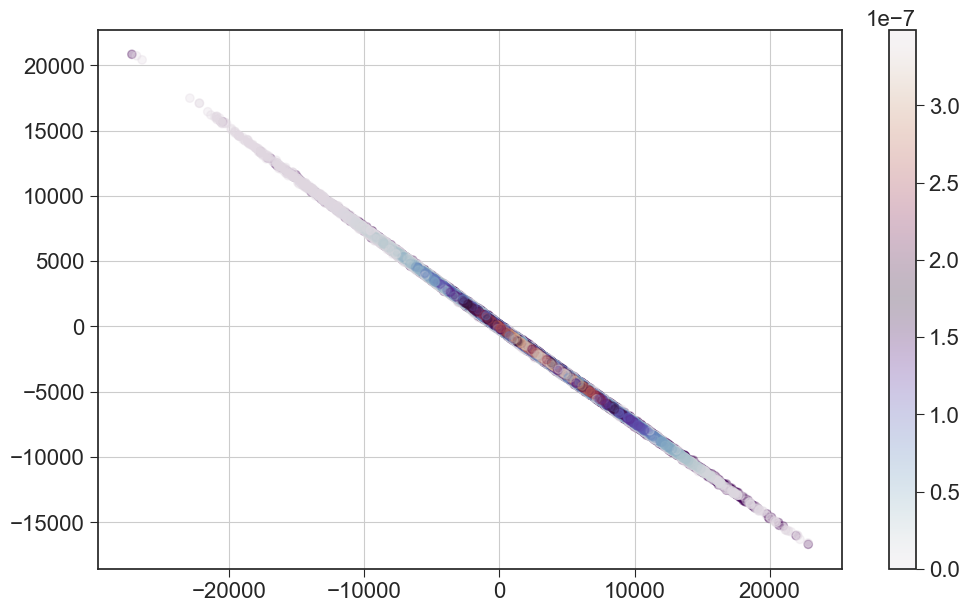

(2, 40000)


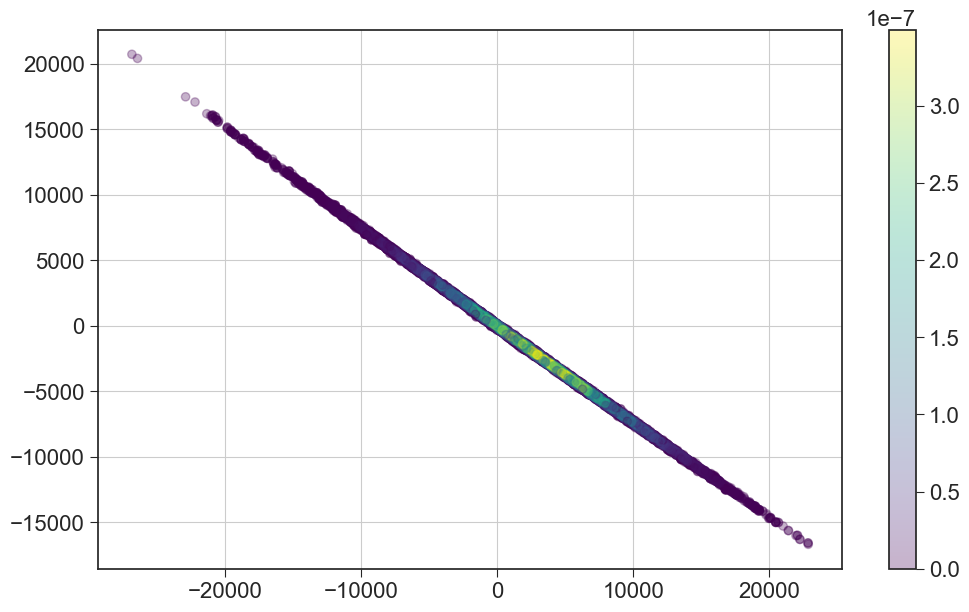

In [21]:
i1, i2 = check_inds[0]
indS = 0
nm = nms[indS]
mbh_samples_attr = mbh_catalog.get_attr_source_samples(nm)
mbh_samples = mbh_catalog.get_source_samples(nm, mbh_samples_attr)
mbh_chain = mbh_samples[mbh_parameters].values

LA, trS =  Rearrange2Common(dat_LA[indS], cats[indS])

x1 = (mbh_chain[skip::10, i1] - trS[i1])
x2 = (mbh_chain[skip::10, i2] - trS[i2])

y1 = (LA[::5, i1] - trS[i1])
y2 = (LA[::5, i2] - trS[i2])

print (x1.shape, y1.shape)
kerP = stats.gaussian_kde(np.vstack([x1, x2]))
kerQ = stats.gaussian_kde(np.vstack([y1, y2]))

plt.scatter(x1, x2, c=kerP(np.vstack([x1, x2])), alpha = 0.3, cmap='viridis')
# plt.colorbar()
# plt.show()

plt.scatter(y1, y2, c=kerP(np.vstack([y1, y2])), alpha = 0.3, cmap='twilight')
plt.colorbar()
plt.show()
sz = 20000 

ind_x = np.random.randint(0, high=len(x1), size=sz)
ind_y = np.random.randint(0, high=len(y1), size=sz)

# print (ind_x)
# print (ind_y)
# x1c = np.concatenate((np.random.choice(x1, sz, replace=False), \
#                           np.random.choice(y1, sz, replace=False)) )
# x2c = np.concatenate((np.random.choice(x2, sz, replace=False), \
#                           np.random.choice(y2, sz, replace=False)) )

x1c = np.concatenate((x1[ind_x], y1[ind_y]))
x2c = np.concatenate((x2[ind_x], y2[ind_y]))
    
    
pnts = np.vstack([x1c, x2c])
print (pnts.shape)

Pis = kerP(pnts)
Qis =  kerQ(pnts)

plt.scatter(pnts[0, :], pnts[1,:], c=Pis, alpha = 0.3, cmap='viridis')
plt.colorbar()
plt.show()




MBH004799207:
0 ['m1', 'm2']
(24691,) (20480,)
m1 - m2 JS 2D->8.6e-03, JS 1D-> 6.9e-03,  6.7e-03 

1 ['chi1', 'chi2']
(24691,) (20480,)
chi1 - chi2 JS 2D->6.3e-03, JS 1D-> 2.7e-03,  2.8e-03 

2 ['m1', 'chi1']
(24691,) (20480,)
m1 - chi1 JS 2D->4.8e-02, JS 1D-> 6.9e-03,  2.7e-03 

3 ['lam', 'bet']
(24691,) (20480,)
lam - bet JS 2D->3.5e-03, JS 1D-> 2.2e-03,  4.1e-03 

4 ['ciota', 'DL']
(24691,) (20480,)
ciota - DL JS 2D->3.5e-02, JS 1D-> 5.9e-03,  3.7e-02 

MBH008746658:
0 ['m1', 'm2']
(24690,) (20480,)
m1 - m2 JS 2D->1.4e-01, JS 1D-> 1.0e-02,  2.9e-02 

1 ['chi1', 'chi2']
(24690,) (20480,)
chi1 - chi2 JS 2D->1.3e-01, JS 1D-> 2.0e-02,  3.6e-02 

2 ['m1', 'chi1']
(24690,) (20480,)
m1 - chi1 JS 2D->2.6e-02, JS 1D-> 1.0e-02,  2.0e-02 

3 ['lam', 'bet']
(24690,) (20480,)
lam - bet JS 2D->1.3e-02, JS 1D-> 8.6e-03,  4.6e-03 

4 ['ciota', 'DL']
(24690,) (20480,)
ciota - DL JS 2D->9.7e-02, JS 1D-> 2.4e-02,  8.1e-02 

MBH011167708:
0 ['m1', 'm2']
(24691,) (20480,)
m1 - m2 JS 2D->7.1e-02, JS 1D->

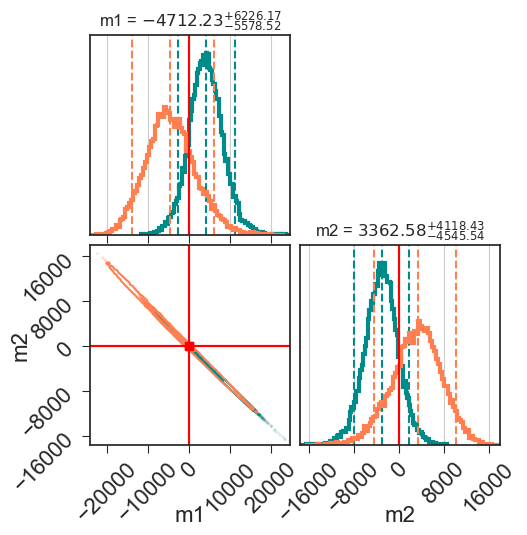

1 ['chi1', 'chi2']
(24691,) (20480,)
chi1 - chi2 JS 2D->1.9e-01, JS 1D-> 2.0e-01,  2.0e-01 

2 ['m1', 'chi1']
(24691,) (20480,)
m1 - chi1 JS 2D->2.0e-01, JS 1D-> 2.1e-01,  2.0e-01 

JS-2d =  0.20015455091472756


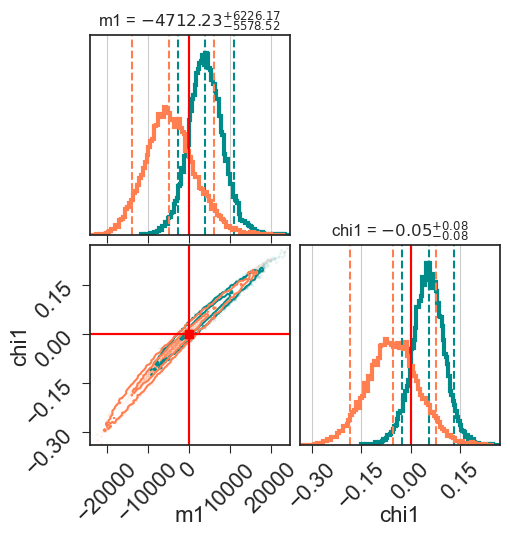

3 ['lam', 'bet']
(24691,) (20480,)
lam - bet JS 2D->4.5e-02, JS 1D-> 1.5e-02,  2.0e-02 

4 ['ciota', 'DL']
(24691,) (20480,)
ciota - DL JS 2D->6.1e-02, JS 1D-> 2.5e-02,  4.4e-02 

MBH011527104:
0 ['m1', 'm2']
(24692,) (20480,)
m1 - m2 JS 2D->5.4e-02, JS 1D-> 6.2e-03,  6.9e-03 

1 ['chi1', 'chi2']
(24692,) (20480,)
chi1 - chi2 JS 2D->1.3e-01, JS 1D-> 2.1e-02,  2.4e-02 

2 ['m1', 'chi1']
(24692,) (20480,)
m1 - chi1 JS 2D->2.6e-01, JS 1D-> 6.2e-03,  2.1e-02 

JS-2d =  0.2564955748212854


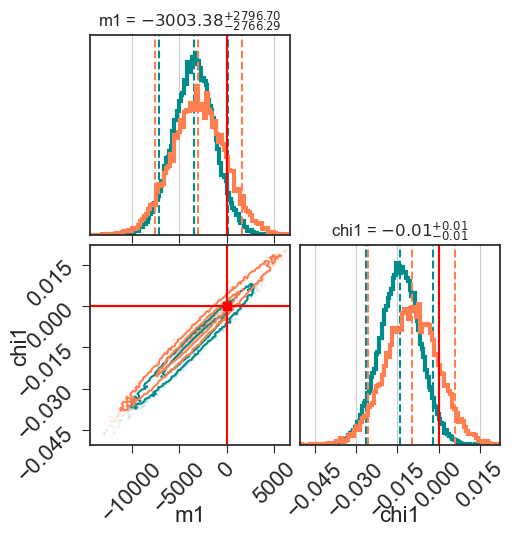

3 ['lam', 'bet']
(24692,) (20480,)
lam - bet JS 2D->3.1e-02, JS 1D-> 7.7e-03,  2.1e-02 

4 ['ciota', 'DL']
(24692,) (20480,)
ciota - DL JS 2D->3.7e-02, JS 1D-> 3.5e-02,  3.2e-02 

MBH011971307:
0 ['m1', 'm2']
(24690,) (20480,)
m1 - m2 JS 2D->5.2e-02, JS 1D-> 4.6e-02,  4.2e-02 

1 ['chi1', 'chi2']
(24690,) (20480,)
chi1 - chi2 JS 2D->6.7e-02, JS 1D-> 5.7e-02,  5.5e-02 

2 ['m1', 'chi1']
(24690,) (20480,)
m1 - chi1 JS 2D->5.6e-02, JS 1D-> 4.6e-02,  5.7e-02 

3 ['lam', 'bet']
(24690,) (20480,)
lam - bet JS 2D->1.7e-02, JS 1D-> 3.9e-03,  5.7e-03 

4 ['ciota', 'DL']
(24690,) (20480,)
ciota - DL JS 2D->3.4e-02, JS 1D-> 4.2e-03,  3.3e-02 

MBH013616810:
0 ['m1', 'm2']
(24692,) (20480,)
m1 - m2 JS 2D->3.7e-02, JS 1D-> 3.8e-02,  3.9e-02 

1 ['chi1', 'chi2']
(24692,) (20480,)
chi1 - chi2 JS 2D->4.6e-02, JS 1D-> 3.3e-02,  3.5e-02 

2 ['m1', 'chi1']
(24692,) (20480,)
m1 - chi1 JS 2D->7.5e-02, JS 1D-> 3.8e-02,  3.3e-02 

3 ['lam', 'bet']
(24692,) (20480,)
lam - bet JS 2D->8.8e-02, JS 1D-> 1.8e-02, 

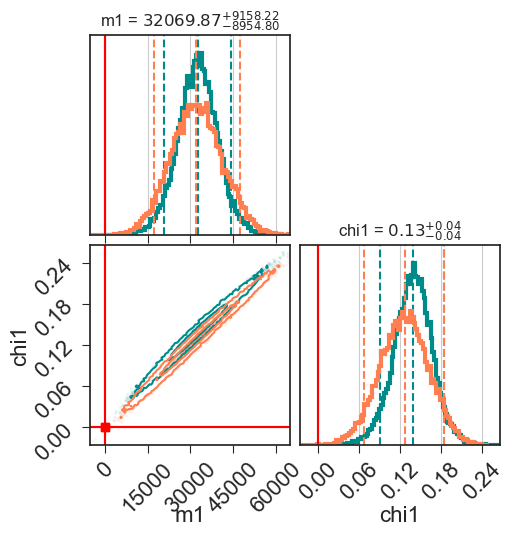

3 ['lam', 'bet']
(24691,) (20480,)
lam - bet JS 2D->1.8e-01, JS 1D-> 1.3e-01,  1.9e-01 

4 ['ciota', 'DL']
(24691,) (20480,)
ciota - DL JS 2D->3.6e-01, JS 1D-> 2.3e-01,  1.1e-01 

JS-2d =  0.35655254907168427


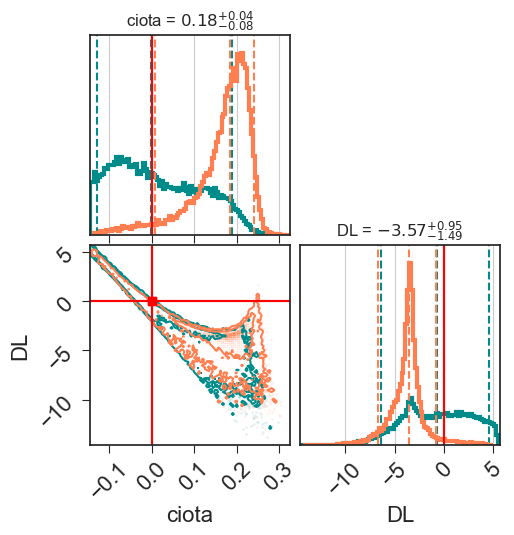

MBH023439946:
0 ['m1', 'm2']
(24691,) (20480,)
m1 - m2 JS 2D->9.0e-02, JS 1D-> 4.7e-02,  3.9e-02 

1 ['chi1', 'chi2']
(24691,) (20480,)
chi1 - chi2 JS 2D->1.3e-01, JS 1D-> 1.6e-02,  1.4e-02 

2 ['m1', 'chi1']
(24691,) (20480,)
m1 - chi1 JS 2D->3.1e-01, JS 1D-> 4.7e-02,  1.6e-02 

JS-2d =  0.30554330853543366


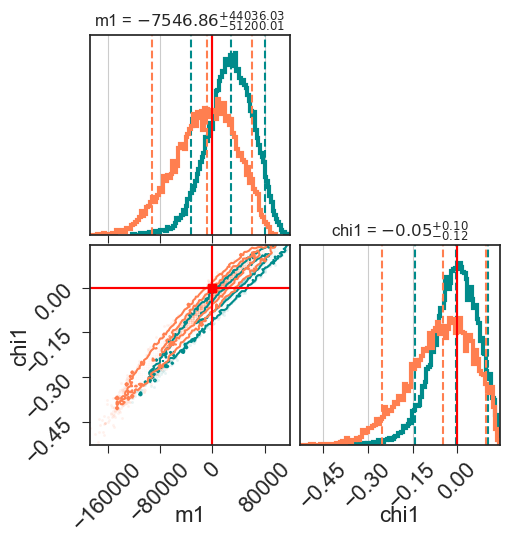

3 ['lam', 'bet']
(24691,) (20480,)
lam - bet JS 2D->1.2e-01, JS 1D-> 1.2e-01,  1.3e-01 

4 ['ciota', 'DL']
(24691,) (20480,)
ciota - DL JS 2D->2.0e-01, JS 1D-> 1.9e-01,  5.2e-02 

JS-2d =  0.20269814139933973


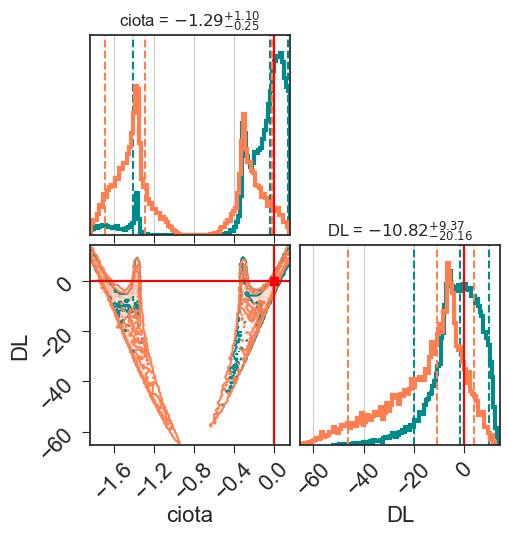

MBH024408802:
0 ['m1', 'm2']
(24691,) (20480,)
m1 - m2 JS 2D->3.9e-02, JS 1D-> 2.6e-02,  2.6e-02 

1 ['chi1', 'chi2']
(24691,) (20480,)
chi1 - chi2 JS 2D->4.2e-02, JS 1D-> 2.6e-02,  2.8e-02 

2 ['m1', 'chi1']
(24691,) (20480,)
m1 - chi1 JS 2D->6.3e-02, JS 1D-> 2.6e-02,  2.6e-02 

3 ['lam', 'bet']
(24691,) (20480,)
lam - bet JS 2D->5.2e-02, JS 1D-> 6.3e-03,  6.3e-02 

4 ['ciota', 'DL']
(24691,) (20480,)
ciota - DL JS 2D->3.3e-02, JS 1D-> 3.5e-02,  7.9e-03 

MBH029514832:
0 ['m1', 'm2']
(24691,) (20480,)
m1 - m2 JS 2D->2.6e-01, JS 1D-> 2.2e-01,  1.5e-01 

JS-2d =  0.2578027767220158


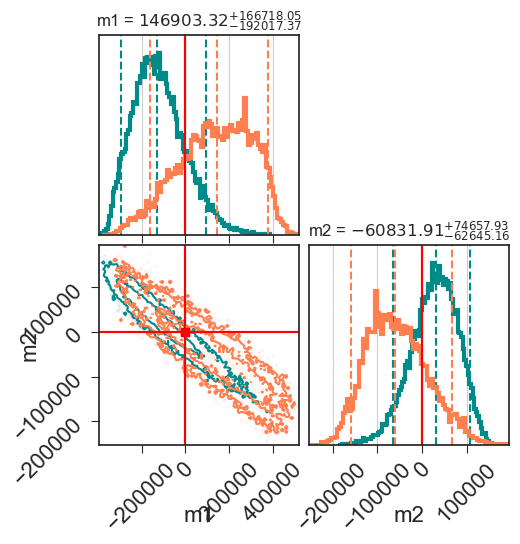

1 ['chi1', 'chi2']
(24691,) (20480,)
chi1 - chi2 JS 2D->2.4e-01, JS 1D-> 2.0e-01,  1.8e-01 

JS-2d =  0.2358265187033008


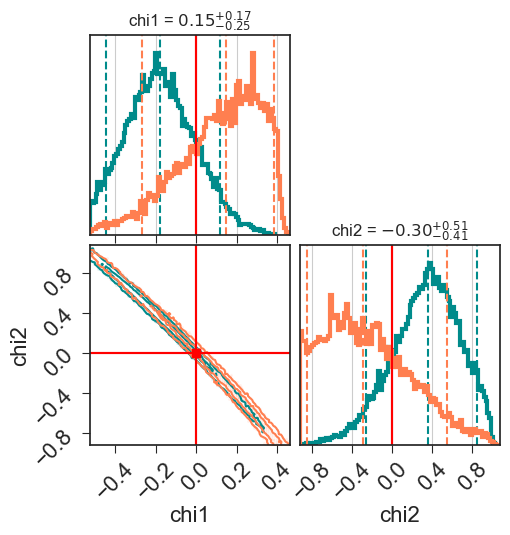

2 ['m1', 'chi1']
(24691,) (20480,)
m1 - chi1 JS 2D->2.9e-01, JS 1D-> 2.2e-01,  2.0e-01 

JS-2d =  0.28766136387022045


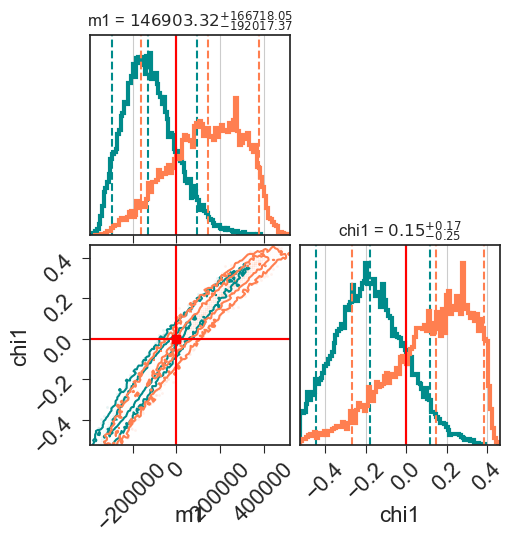

3 ['lam', 'bet']
(24691,) (20480,)
lam - bet JS 2D->1.4e-02, JS 1D-> 7.6e-03,  5.5e-03 

4 ['ciota', 'DL']
(24691,) (20480,)
ciota - DL JS 2D->2.3e-02, JS 1D-> 5.1e-03,  1.8e-02 



In [22]:


JSthr = 0.2

report = ''
plotit = True
for indS in range(len(nms)):
    LA, trS =  Rearrange2Common(dat_LA[indS], cats[indS])
    nm = nms[indS]
    print (nm + ':')
    mbh_samples_attr = mbh_catalog.get_attr_source_samples(nm)
    mbh_samples = mbh_catalog.get_source_samples(nm, mbh_samples_attr)
    mbh_chain = mbh_samples[mbh_parameters].values
    
    report += nm + ': \n'
    for ii, lbl in enumerate(check_lbls):
        rec = ''
        print (ii, lbl)
        i1, i2 = check_inds[ii]
        x1 = (mbh_chain[skip::10, i1] - trS[i1])
        x2 = (mbh_chain[skip::10, i2] - trS[i2])

        y1 = (LA[::5, i1] - trS[i1])
        y2 = (LA[::5, i2] - trS[i2])
        
        print (x1.shape, y1.shape)
        
        [KL2d, JS2d], [KL1da, JS1da],[KL1db, JS1db]  = JSD2d([x1, x2], [y1, y2])
        
        rec += lbl[0] + " - " + lbl[1] + \
                f' JS 2D->{JS2d:1.1e}, JS 1D->{JS1da: 1.1e}, {JS1db: 1.1e} \n'
#         print ([KL2d, JS2d], [KL1da, JS1da],[KL1db, JS1db])
        print (rec)
        if (JS2d >= JSthr and plotit):
            print ('JS-2d = ', JS2d)
            
            figJS = corner.corner(np.array([x1, x2]).T,  bins=100, hist_kwargs={'density':True, 'lw':3}, 
            plot_datapoints=True, fill_contours=False, quantiles=[0.05, 0.5, 0.95],
            show_titles=True, color='darkcyan', truths=[0.0, 0.0], truth_color='r', use_math_test=True,
            levels=[0.7, 0.99], title_kwargs={"fontsize": 12}, labels=lbl)#,range = rng)
            
            corner.corner(np.array([y1, y2]).T, fig=figJS,  bins=100, hist_kwargs={'density':True, 'lw':3}, 
            plot_datapoints=True, fill_contours=False, quantiles=[0.05, 0.5, 0.95],
            show_titles=True, color='coral', truths=[0.0, 0.0], truth_color='r', use_math_test=True,
            levels=[0.7, 0.99], title_kwargs={"fontsize": 12}, labels=lbl)
            plt.show() 
            
        report += rec
        
        

In [23]:
print (report)

MBH004799207: 
m1 - m2 JS 2D->8.6e-03, JS 1D-> 6.9e-03,  6.7e-03 
chi1 - chi2 JS 2D->6.3e-03, JS 1D-> 2.7e-03,  2.8e-03 
m1 - chi1 JS 2D->4.8e-02, JS 1D-> 6.9e-03,  2.7e-03 
lam - bet JS 2D->3.5e-03, JS 1D-> 2.2e-03,  4.1e-03 
ciota - DL JS 2D->3.5e-02, JS 1D-> 5.9e-03,  3.7e-02 
MBH008746658: 
m1 - m2 JS 2D->1.4e-01, JS 1D-> 1.0e-02,  2.9e-02 
chi1 - chi2 JS 2D->1.3e-01, JS 1D-> 2.0e-02,  3.6e-02 
m1 - chi1 JS 2D->2.6e-02, JS 1D-> 1.0e-02,  2.0e-02 
lam - bet JS 2D->1.3e-02, JS 1D-> 8.6e-03,  4.6e-03 
ciota - DL JS 2D->9.7e-02, JS 1D-> 2.4e-02,  8.1e-02 
MBH011167708: 
m1 - m2 JS 2D->7.1e-02, JS 1D-> 5.1e-03,  5.9e-03 
chi1 - chi2 JS 2D->4.5e-02, JS 1D-> 6.3e-03,  5.9e-03 
m1 - chi1 JS 2D->6.0e-03, JS 1D-> 5.1e-03,  6.3e-03 
lam - bet JS 2D->4.6e-02, JS 1D-> 4.6e-02,  3.9e-02 
ciota - DL JS 2D->1.9e-01, JS 1D-> 2.2e-01,  1.8e-01 
MBH011258533: 
m1 - m2 JS 2D->2.2e-01, JS 1D-> 2.1e-01,  2.1e-01 
chi1 - chi2 JS 2D->1.9e-01, JS 1D-> 2.0e-01,  2.0e-01 
m1 - chi1 JS 2D->2.0e-01, JS 1D-> 2.

### Let me have a look at a particular MBHB

MBH029514832:
0 ['m1', 'm2']
(24691,) (20480,)
m1 - m2 JS 2D->2.6e-01, JS 1D-> 2.2e-01,  1.5e-01 

JS-2d =  0.2601052422899411


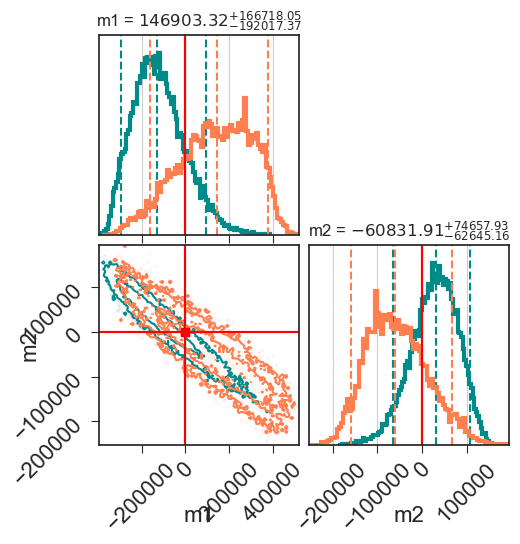

1 ['chi1', 'chi2']
(24691,) (20480,)
chi1 - chi2 JS 2D->2.4e-01, JS 1D-> 2.0e-01,  1.8e-01 

JS-2d =  0.2358643679256914


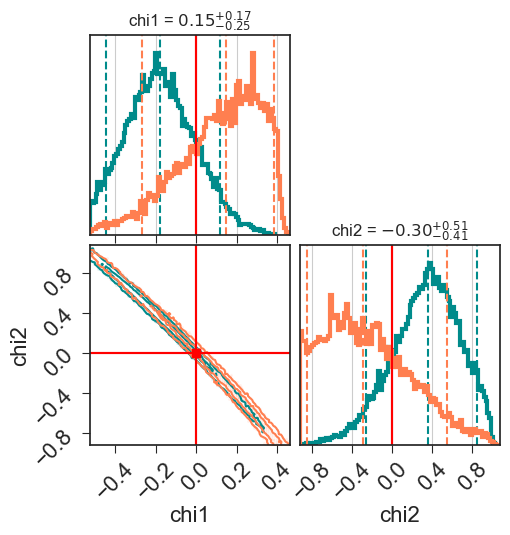

2 ['m1', 'chi1']
(24691,) (20480,)
m1 - chi1 JS 2D->2.9e-01, JS 1D-> 2.2e-01,  2.0e-01 

JS-2d =  0.28741306136358497


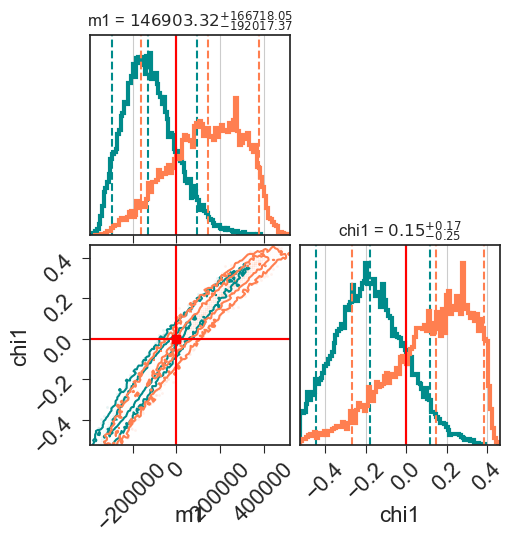

3 ['lam', 'bet']
(24691,) (20480,)
lam - bet JS 2D->1.4e-02, JS 1D-> 7.5e-03,  5.5e-03 

JS-2d =  0.01404646006184391


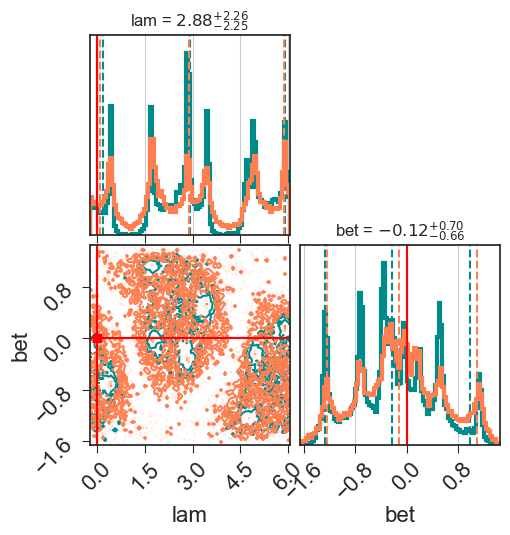

4 ['ciota', 'DL']
(24691,) (20480,)
ciota - DL JS 2D->2.2e-02, JS 1D-> 5.1e-03,  1.8e-02 

JS-2d =  0.022475487324164233


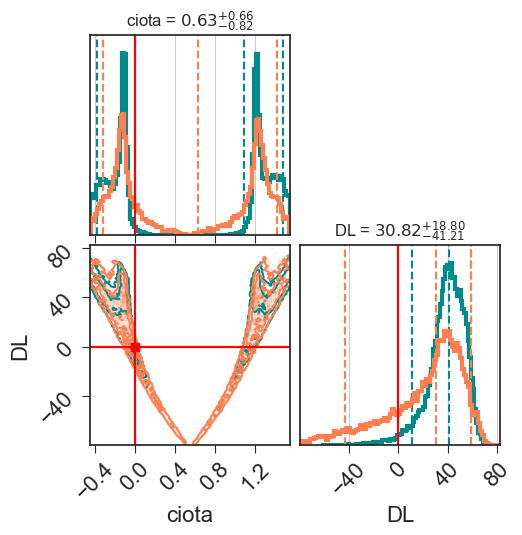

In [24]:
nm = 'MBH011258533'
indS = 3
# MBH020426286
# 10
# MBH022228026
# MBH023439946:
# MBH029514832

indS = 14
nm = nms[indS]
print (nm + ':')
# alendc;k 
mbh_samples_attr = mbh_catalog.get_attr_source_samples(nm)
mbh_samples = mbh_catalog.get_source_samples(nm, mbh_samples_attr)
mbh_chain = mbh_samples[mbh_parameters].values
LA, trS =  Rearrange2Common(dat_LA[indS], cats[indS])

for ii, lbl in enumerate(check_lbls):
    rec = ''
    print (ii, lbl)
    i1, i2 = check_inds[ii]
    x1 = (mbh_chain[skip::10, i1] - trS[i1])
    x2 = (mbh_chain[skip::10, i2] - trS[i2])

    y1 = (LA[::5, i1] - trS[i1])
    y2 = (LA[::5, i2] - trS[i2])
        
    print (x1.shape, y1.shape)
    
    kerP = stats.gaussian_kde(np.vstack([x1, x2]))
    kerQ = stats.gaussian_kde(np.vstack([y1, y2]))
    minsz = 20000
    sz = min(len(x1), len(y1), minsz)
#     print ('min size', sz)
    ind_x = np.random.randint(0, high=len(x1), size=sz)
    ind_y = np.random.randint(0, high=len(y1), size=sz)
    x1c = np.concatenate((x1[ind_x], y1[ind_y]))
    x2c = np.concatenate((x2[ind_x], y2[ind_y]))
#     print ('data size', x1c.shape)
    pnts = np.vstack([x1c, x2c])
    
    Pis = kerP(pnts)
    Qis =  kerQ(pnts)
    Pis = np.clip(Pis, 1.e-30, None)
    Qis = np.clip(Qis, 1.e-30, None)
    
    PisN = Pis/np.sum(Pis)
    QisN = Qis/np.sum(Qis)
    MisN = 0.5*(PisN + QisN)
    
    
    
#     print ('MisN', np.log(MisN))
#     print ('PisN', np.log(Pis))
#     print ('QisN', np.log(QisN))
#     print ('M', np.argwhere(MisN <= 0.0))
#     print ('P', np.argwhere(PisN <= 0.0))
#     print ('Q', np.argwhere(QisN <= 0.0))
    
#     KL2d = np.sum(PisN * np.log(PisN/QisN))
    JS2d = 0.5*(np.sum(PisN * np.log(PisN/MisN)) + np.sum(QisN * np.log(QisN/MisN)))
    
    KL1da, JS1da = JSD1d(x1, y1, minsz)
    KL1db, JS1db = JSD1d(x2, y2, minsz)
        
#     [KL2d, JS2d], [KL1da, JS1da],[KL1db, JS1db]  = JSD2d([x1, x2], [y1, y2])
        
    rec += lbl[0] + " - " + lbl[1] + \
                f' JS 2D->{JS2d:1.1e}, JS 1D->{JS1da: 1.1e}, {JS1db: 1.1e} \n'

    print (rec)
    if (plotit):
            print ('JS-2d = ', JS2d)
            
            figJS = corner.corner(np.array([x1, x2]).T,  bins=100, hist_kwargs={'density':True, 'lw':3}, 
            plot_datapoints=True, fill_contours=False, quantiles=[0.05, 0.5, 0.95],
            show_titles=True, color='darkcyan', truths=[0.0, 0.0], truth_color='r', use_math_test=True,
            levels=[0.7, 0.99], title_kwargs={"fontsize": 12}, labels=lbl)#,range = rng)
            
            corner.corner(np.array([y1, y2]).T, fig=figJS,  bins=100, hist_kwargs={'density':True, 'lw':3}, 
            plot_datapoints=True, fill_contours=False, quantiles=[0.05, 0.5, 0.95],
            show_titles=True, color='coral', truths=[0.0, 0.0], truth_color='r', use_math_test=True,
            levels=[0.7, 0.99], title_kwargs={"fontsize": 12}, labels=lbl)
            plt.show() 

In [25]:
np.log(2)

0.6931471805599453